<a href="https://colab.research.google.com/github/simon-hochmuth/portfolio/blob/master/Credit_card_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# import tools

In [0]:
from sklearn.datasets import fetch_openml
import umap
from tabulate import tabulate
!pip install umap-learn
from sklearn.datasets import fetch_openml
import umap
import time
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy import special
from scipy.special import comb
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import silhouette_score
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy import stats
from scipy.stats import yeojohnson
from sqlalchemy import create_engine
import warnings
from scipy.stats import boxcox
from scipy import stats
import seaborn as sns
%matplotlib inline
from sklearn.metrics import confusion_matrix, precision_score, recall_score
from sklearn import ensemble
pd.options.display.float_format = '{:.3f}'.format
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
import statsmodels.api as sm
import time
from statsmodels.tools.eval_measures import mse, rmse
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, fbeta_score, classification_report
from sklearn.metrics import roc_curve, precision_recall_curve, roc_auc_score
from scipy.stats import bartlett
from scipy.stats import levene
from statsmodels.tsa.stattools import acf
from scipy.stats import jarque_bera
from scipy.stats import normaltest
from sklearn import ensemble
from scipy.stats.mstats import winsorize
import warnings
from scipy import stats
from sklearn import tree
from sklearn import neighbors
!pip install pydotplus
!pip install graphviz
from IPython.display import HTML
import base64
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans
from IPython.display import HTML
import base64
from smart_open import open
import io
from google.colab import files
# function that takes in a dataframe and creates a text link to  
# download it (will only work for files < 2MB or so)
import urllib.request  # the lib that handles the url stuff
import seaborn as sns
from scipy import stats
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from sklearn import datasets, metrics
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import DBSCAN
from matplotlib.patches import Ellipse

from sklearn.mixture import GaussianMixture
warnings.filterwarnings(action="ignore")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# CREDIT CARD CLUSTERING 

### Dataset from Kaggle : https://www.kaggle.com/arjunbhasin2013/ccdata

Here are descriptions of the features



1.   CUSTID : Identification of Credit Card holder (Categorical)
2.   BALANCE : Balance amount left in their account to make purchases 
3.   BALANCEFREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
4.   PURCHASES : Amount of purchases made from account
5.   ONEOFFPURCHASES : Maximum purchase amount done in one-go
6.   INSTALLMENTSPURCHASES : Amount of purchase done in installment
7.   CASHADVANCE : Cash in advance given by the user
8.   PURCHASESFREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
9.   ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
10.   PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
11.   CASHADVANCEFREQUENCY : How frequently the cash in advance being paid
12.   CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"
13.   PURCHASESTRX : Numbe of purchase transactions made
14.   CREDITLIMIT : Limit of Credit Card for user
15.   PAYMENTS : Amount of Payment done by user
16.   MINIMUM_PAYMENTS : Minimum amount of payments made by user
17.   PRCFULLPAYMENT : Percent of full payment paid by user
18.   TENURE : Tenure of credit card service for user














### Goal of Dataset

This case requires to develop a customer segmentation to define marketing strategy. The
sample Dataset summarizes the usage behavior of about 9000 active credit card holders during the last 6 months. The file is at a customer level with 18 behavioral variables. 

The first step is to segment or split up the customers into groups based on differences in the features. This will be done using unsupervised learning techniques to create data clusters

The second step is to describe each cluster, then create marketing strategies based on the core factors of each group.

### Upload files

In [0]:
uploaded = files.upload()


Saving CC GENERAL.csv to CC GENERAL (3).csv


In [0]:
credit_df = pd.read_csv(io.BytesIO(uploaded['CC GENERAL.csv']))

In [0]:
credit_df = credit_df.drop(columns = 'CUST_ID')
print(credit_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 17 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   int64  
 11  PURCHASES_TRX                     8950 non-null   int64  
 12  CREDIT

### Clean up missing data

In [0]:
print(credit_df.isnull().sum().sort_values(ascending=False).head())

MINIMUM_PAYMENTS       313
CREDIT_LIMIT             1
TENURE                   0
PURCHASES_FREQUENCY      0
BALANCE_FREQUENCY        0
dtype: int64


check out the stats behind the two columns with missing data

In [0]:
print('This is the stats for column MINIMUM_PAYMENTS: \n mean = {} , min = {} , median = {} , max = {}'.format(credit_df.MINIMUM_PAYMENTS.mean(),credit_df.MINIMUM_PAYMENTS.min(),credit_df.MINIMUM_PAYMENTS.median(),credit_df.MINIMUM_PAYMENTS.max()))
print('This is the stats for column CREDIT_LIMIT: \n mean = {} , min = {} , median = {} , max = {}'.format(credit_df.CREDIT_LIMIT.mean(),credit_df.CREDIT_LIMIT.min(),credit_df.CREDIT_LIMIT.median(),credit_df.CREDIT_LIMIT.max()))

This is the stats for column MINIMUM_PAYMENTS: 
 mean = 864.2065423050814 , min = 0.019163 , median = 312.343947 , max = 76406.20752000001
This is the stats for column CREDIT_LIMIT: 
 mean = 4494.449450364621 , min = 50.0 , median = 3000.0 , max = 30000.0


looks like the mean is skewed due the the large outliers in the dataset, therefore median may make more sense to use for data replacement.

In [0]:

credit_df["MINIMUM_PAYMENTS"].fillna(credit_df["MINIMUM_PAYMENTS"].median(), inplace=True)
credit_df["CREDIT_LIMIT"].fillna(credit_df["CREDIT_LIMIT"].median(), inplace=True)
print(credit_df.isnull().sum().sort_values(ascending=False).head())

TENURE                        0
ONEOFF_PURCHASES_FREQUENCY    0
BALANCE_FREQUENCY             0
PURCHASES                     0
ONEOFF_PURCHASES              0
dtype: int64


Now the missing values are fixed, double check there arent any other variable types in the columns other than numbers

In [0]:
# print all values that cannot be converted to float
for column_name in list(credit_df.columns):
    print("These are the non-float values for the variable: {}".format(column_name))
        
    for value in credit_df[column_name]:
        try:
            float(value)
        except:
            print(value)

These are the non-float values for the variable: BALANCE
These are the non-float values for the variable: BALANCE_FREQUENCY
These are the non-float values for the variable: PURCHASES
These are the non-float values for the variable: ONEOFF_PURCHASES
These are the non-float values for the variable: INSTALLMENTS_PURCHASES
These are the non-float values for the variable: CASH_ADVANCE
These are the non-float values for the variable: PURCHASES_FREQUENCY
These are the non-float values for the variable: ONEOFF_PURCHASES_FREQUENCY
These are the non-float values for the variable: PURCHASES_INSTALLMENTS_FREQUENCY
These are the non-float values for the variable: CASH_ADVANCE_FREQUENCY
These are the non-float values for the variable: CASH_ADVANCE_TRX
These are the non-float values for the variable: PURCHASES_TRX
These are the non-float values for the variable: CREDIT_LIMIT
These are the non-float values for the variable: PAYMENTS
These are the non-float values for the variable: MINIMUM_PAYMENTS
The

### Let us look at the data  to see any correlations

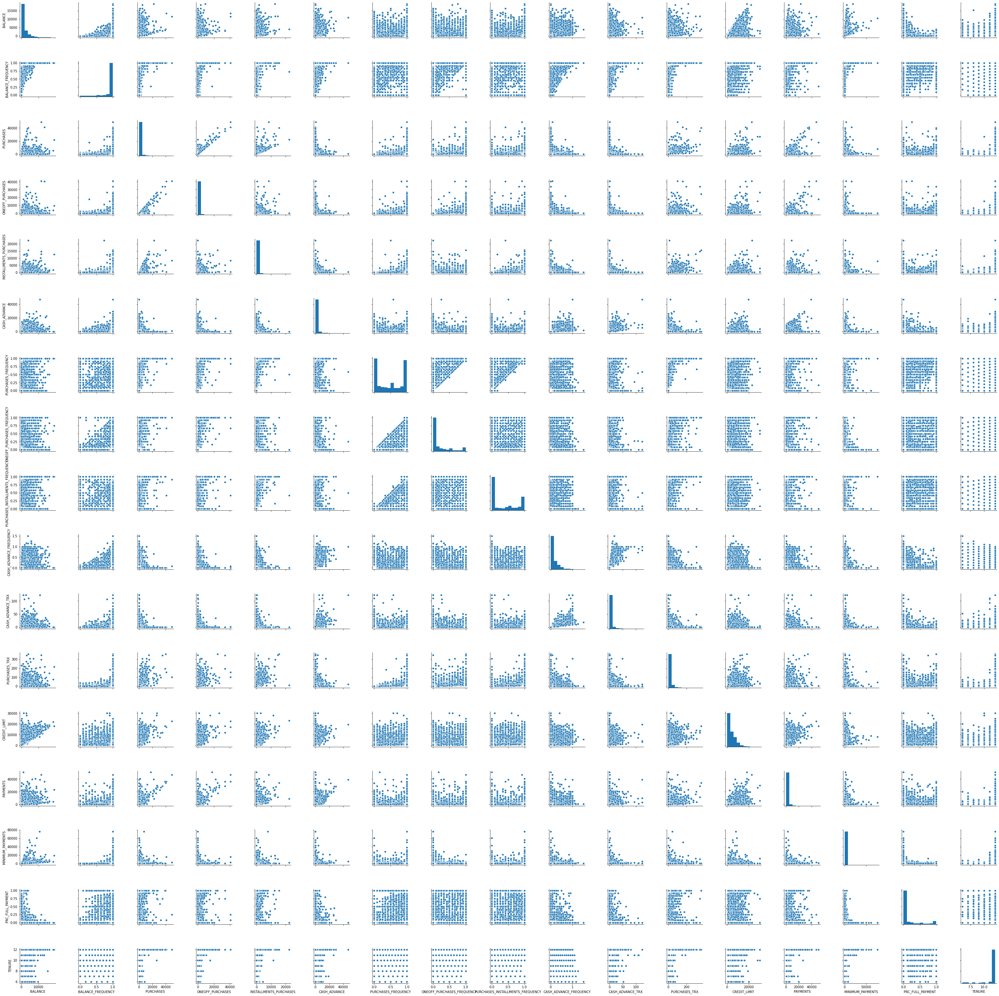

In [0]:
sns.pairplot(credit_df)

We can see alot of values that look correlated, however let us confirm with a correlation matrix

Text(0.5, 1.0, 'correlation matrix ')

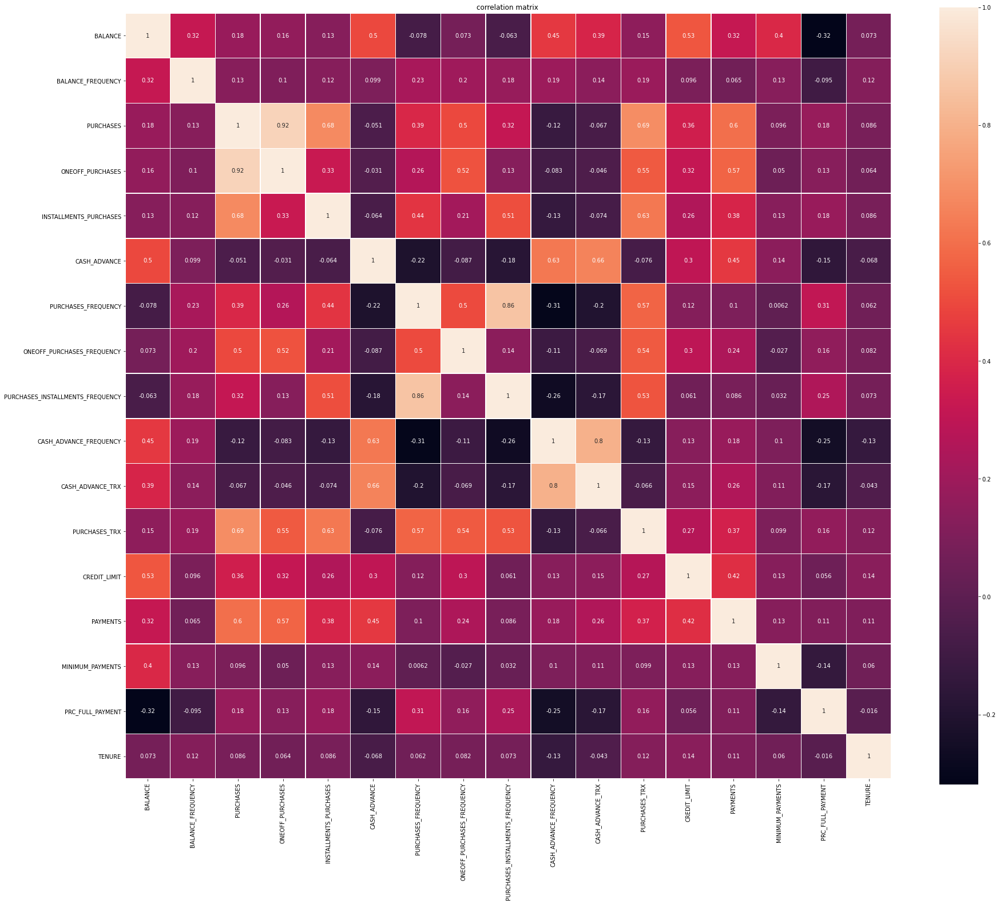

In [0]:
plt.figure(figsize = (30,25))
corrmat = credit_df.corr()
# draw the heatmap using seaborn.
sns.heatmap(corrmat, square=True, annot=True, linewidths=.5)
plt.title("correlation matrix ")

All 17 columns have no missing data, and seem to have a strong correlation with eachother. Obvious correlations between Payments and purchases, or Cash advance and cash advance frequency. Tenure, minumum payments and balance frequency all seem to have low correlation to pretty much everything. 

Now plot histograms/winsorize transforms/yeojohnson to see how the data looks.

These are graphs for column: BALANCE


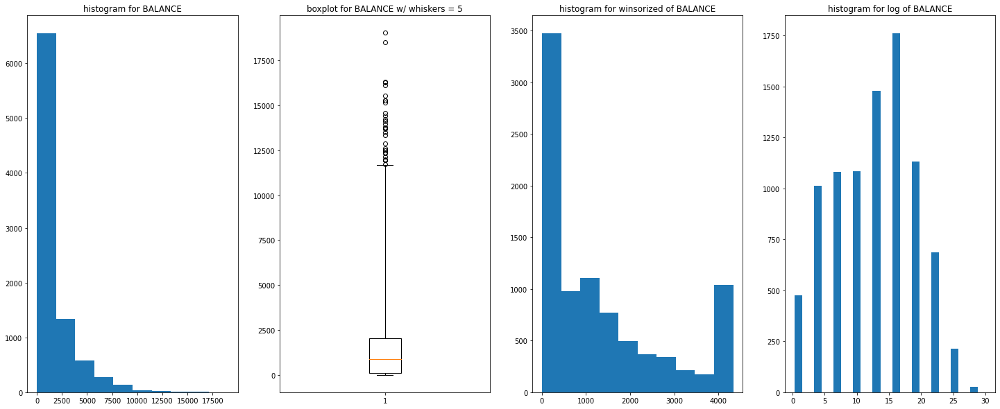

These are graphs for column: BALANCE_FREQUENCY


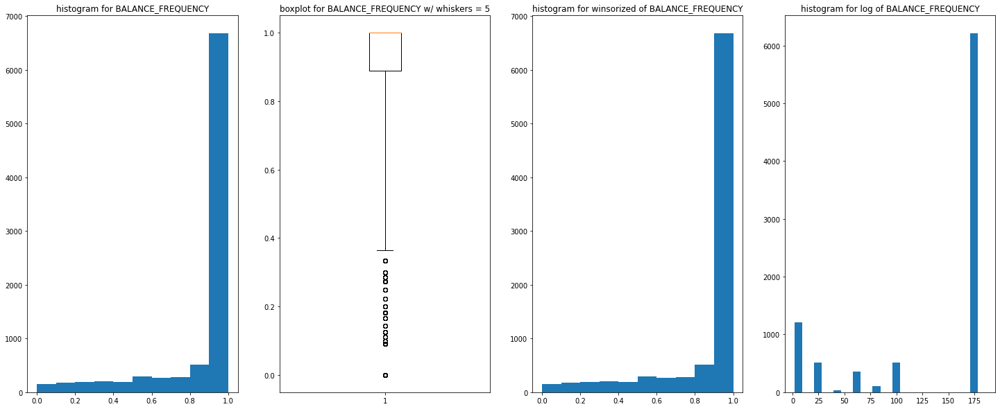

These are graphs for column: PURCHASES


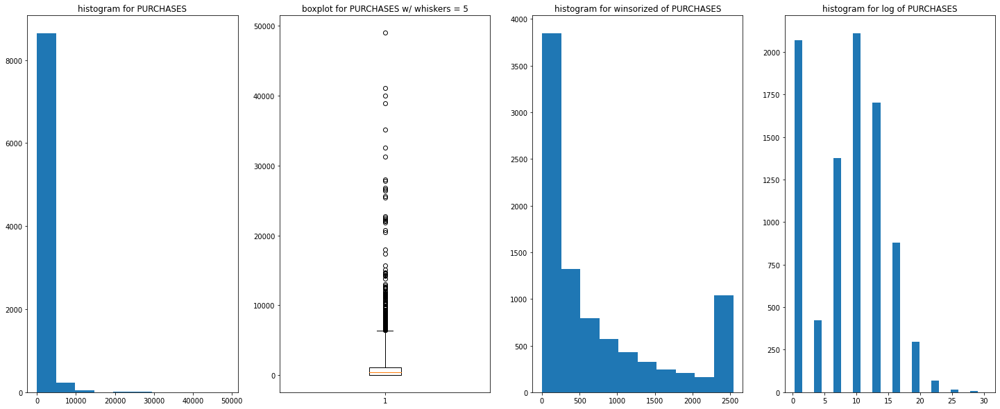

These are graphs for column: ONEOFF_PURCHASES


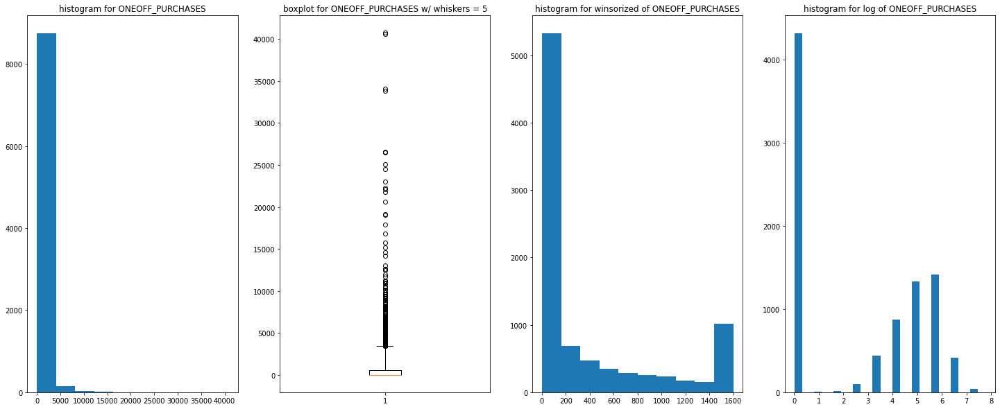

These are graphs for column: INSTALLMENTS_PURCHASES


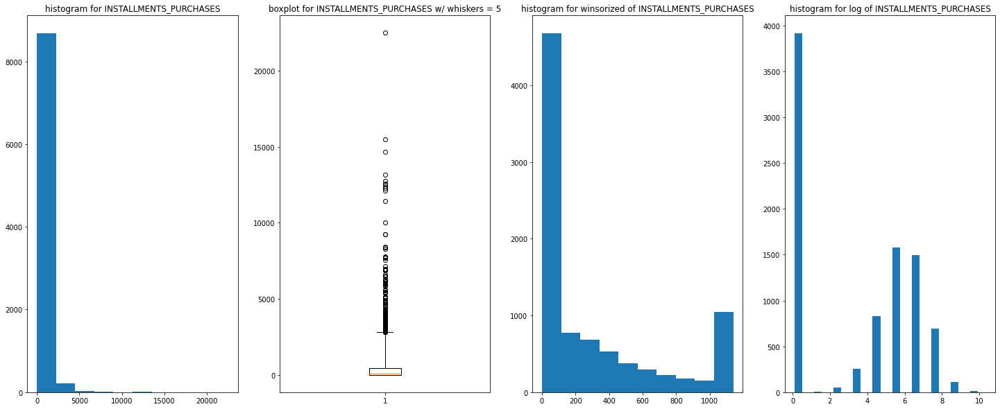

These are graphs for column: CASH_ADVANCE


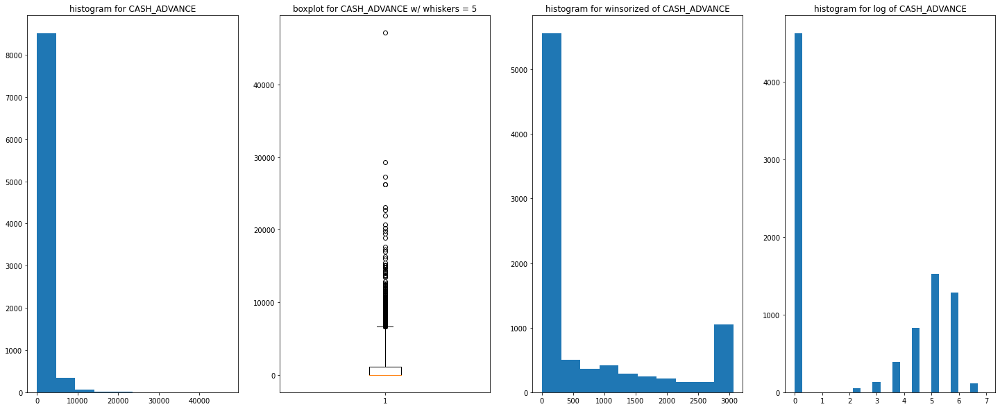

These are graphs for column: PURCHASES_FREQUENCY


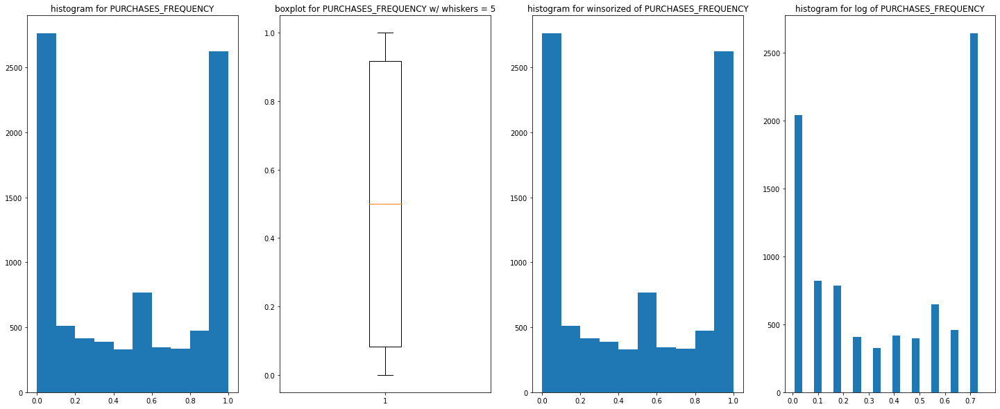

These are graphs for column: ONEOFF_PURCHASES_FREQUENCY


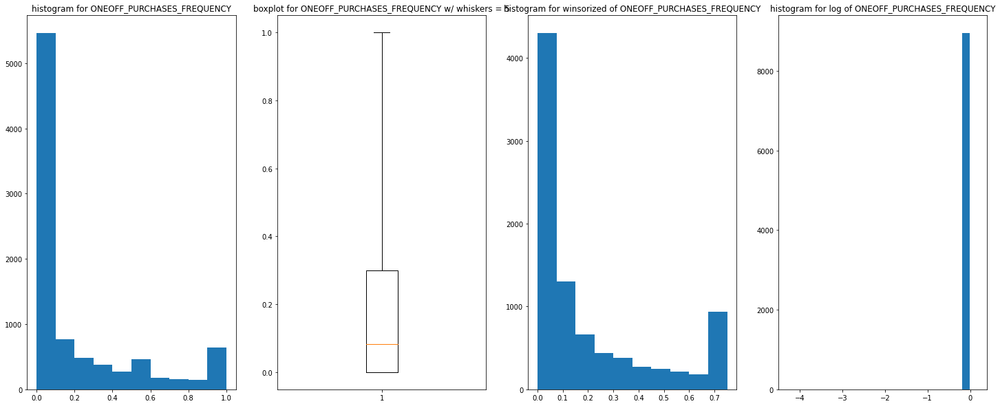

These are graphs for column: PURCHASES_INSTALLMENTS_FREQUENCY


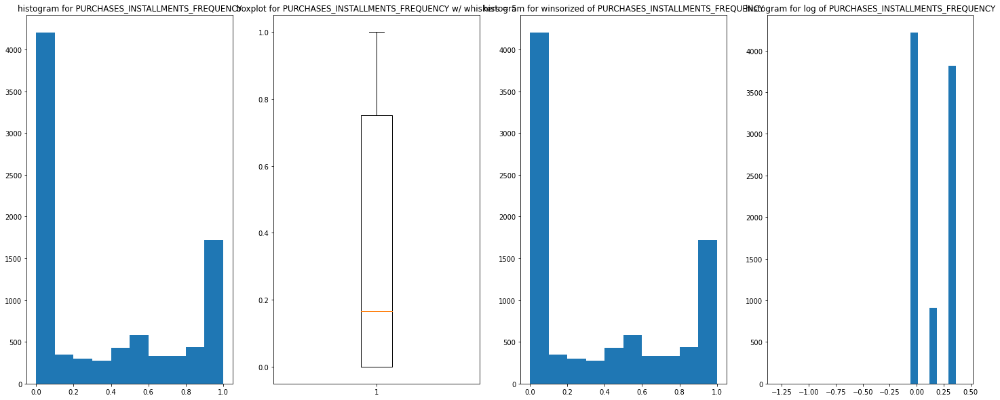

These are graphs for column: CASH_ADVANCE_FREQUENCY


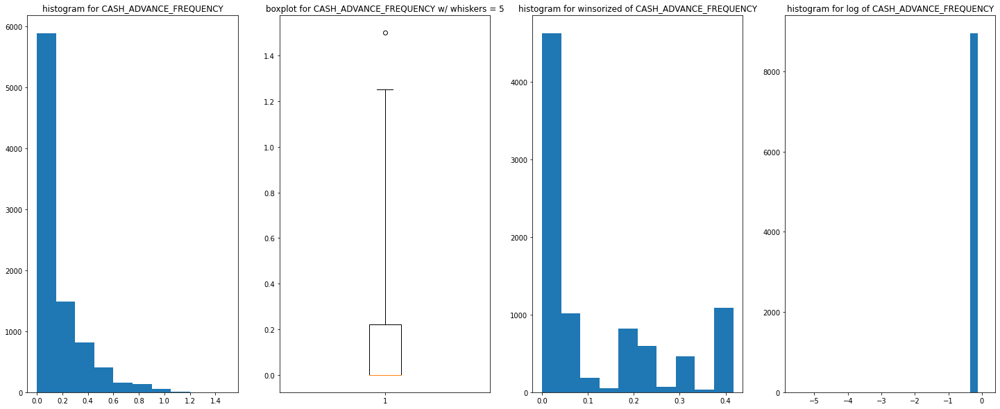

These are graphs for column: CASH_ADVANCE_TRX


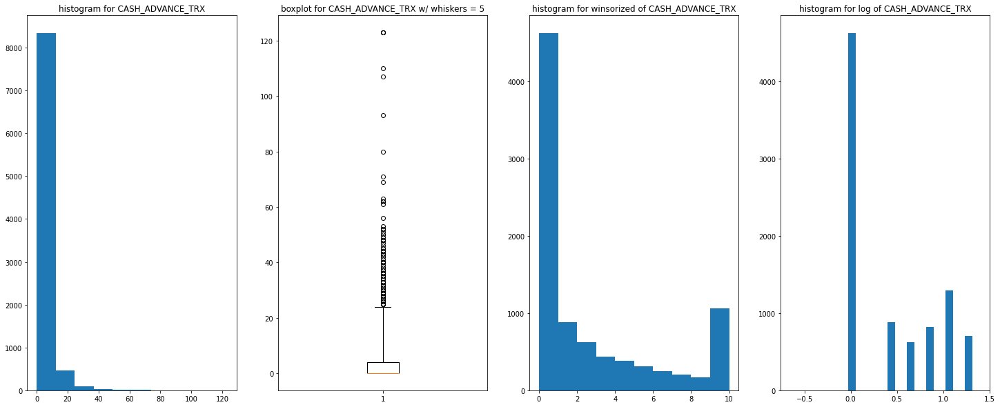

These are graphs for column: PURCHASES_TRX


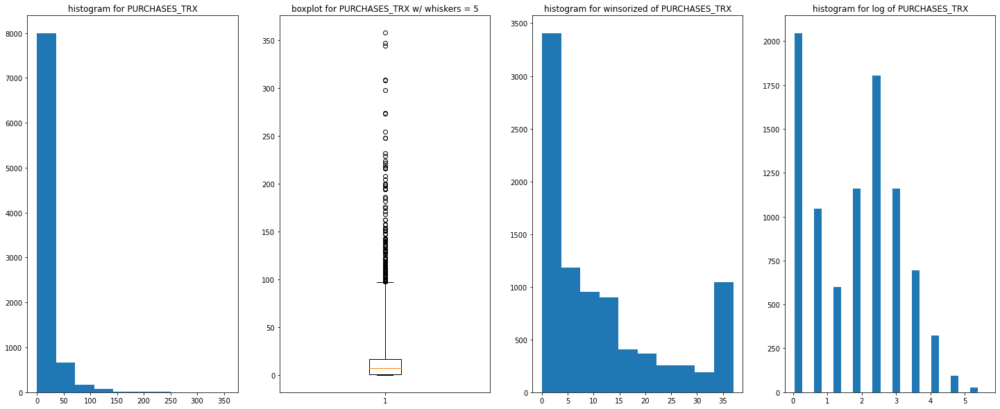

These are graphs for column: CREDIT_LIMIT


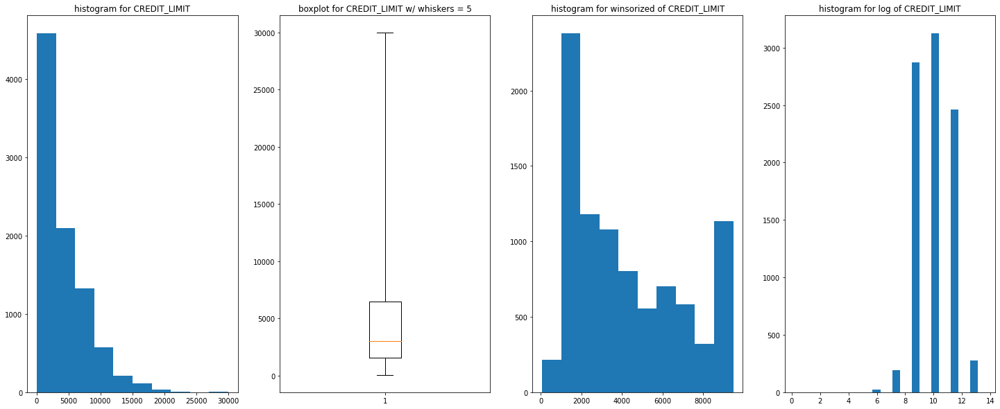

These are graphs for column: PAYMENTS


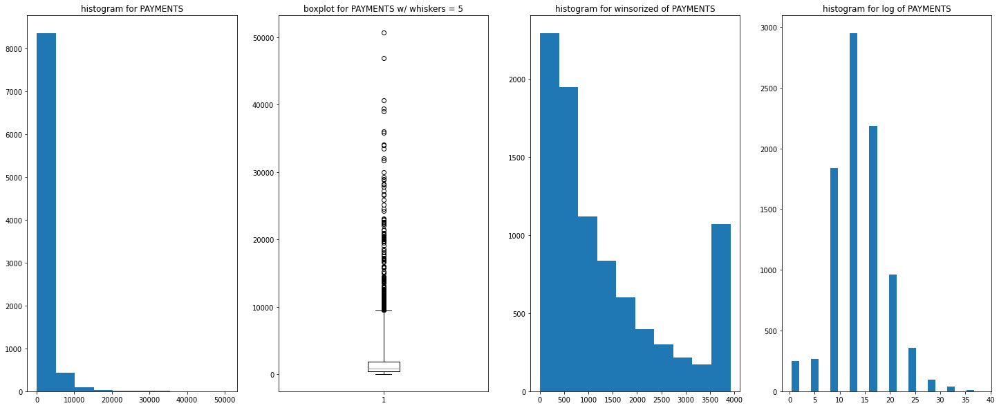

These are graphs for column: MINIMUM_PAYMENTS


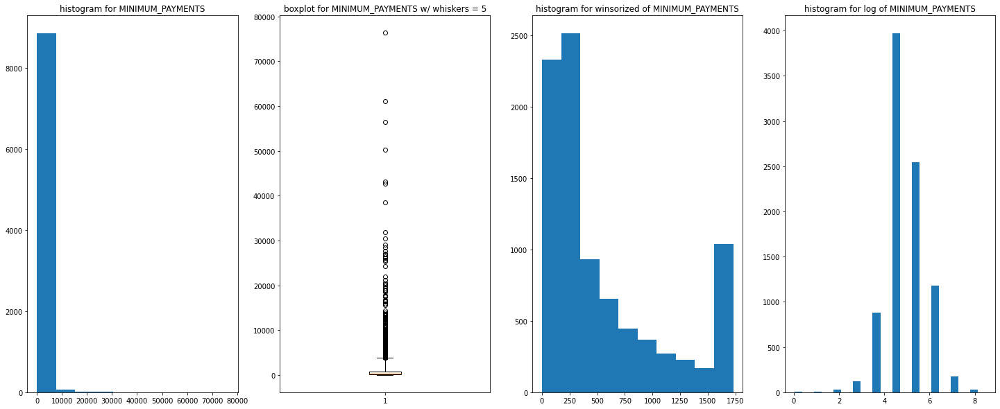

These are graphs for column: PRC_FULL_PAYMENT


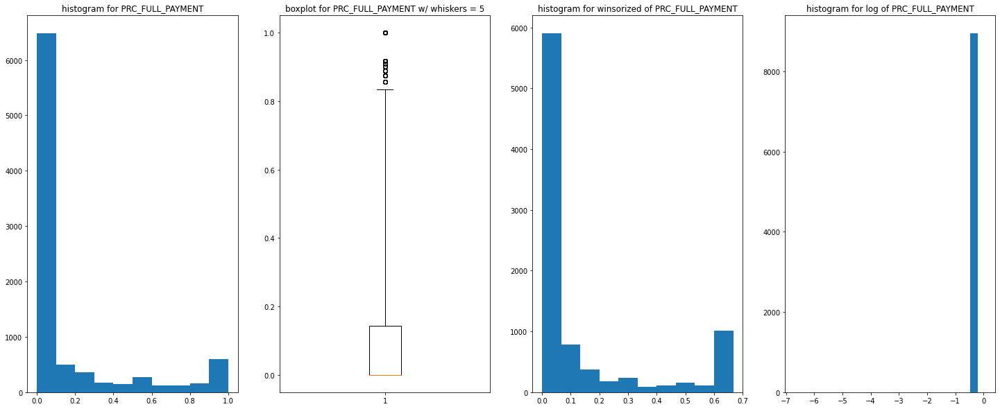

These are graphs for column: TENURE


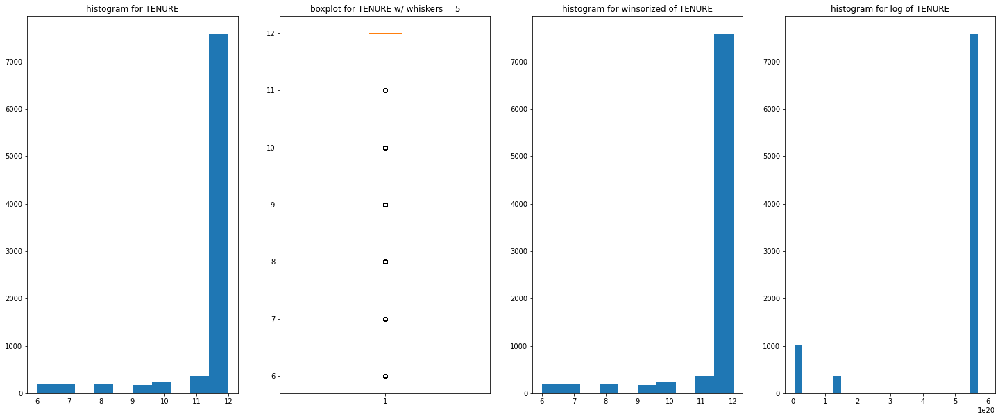

In [0]:
i = 1
y = list(credit_df.columns)
for column_name in y:
    print("These are graphs for column: {}".format(column_name))
    plt.figure(figsize = (25,10))
    plt.subplot(1,4,i)
    plt.hist(credit_df[column_name])
    plt.title('histogram for {}'.format(column_name))
    i += 1
    plt.subplot(1,4,i)
    plt.boxplot(credit_df[column_name],whis = 5)
    plt.title('boxplot for {} w/ whiskers = 5'.format(column_name))
    i += 1
    plt.subplot(1,4,i)
    plt.hist(winsorize(credit_df[column_name],(0,0.1)))
    plt.title('histogram for winsorized of {}'.format(column_name))
    i += 1
    plt.subplot(1,4,i)
    plt.hist(yeojohnson(credit_df[column_name]))
    plt.title('histogram for log of {}'.format(column_name))
    i = 1 
    plt.tight_layout
    plt.show()

Looks like alot of outliers are in the original dataset. If winsorize is done, the data still seems to be a little cleaner, but only in a few cases. Yeojohnson transform seems to only a few of the features also. It may be worth it to transform the features into ranges of 0 - 10 for analysis purposes. Also since the point of the model is to classify customers for marketing purposes, it may be worth it to keep outliers. This is especially true for cases where people are more "risky" investments. 

Description of the ranges chosen are below. This will be the second dataframe that will be used for purposes of grouping data. 

Features with Values Between 0 - 1 <br>
 'BALANCE_FREQUENCY','PURCHASES_FREQUENCY','ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY','CASH_ADVANCE_FREQUENCY','PRC_FULL_PAYMENT'
<br>
<br>

Features with Values between 0 and 40k+ with majority of values under 10k <br>
 'PURCHASES', 'ONEOFF_PURCHASES', 'CASH_ADVANCE', 'PAYMENTS', 'MINIMUM_PAYMENTS'
<br>
<br>

Features with Values between 0 and 20k+ with majority of values under 10k <br>
'BALANCE', 'INSTALLMENTS_PURCHASES', 'CREDIT_LIMIT'<br>
<br>

Features with Values between 0 and 500 with most values under 50 <br>
 'CASH_ADVANCE_TRX', 'PURCHASES_TRX'


### The values above can possibly be split into 5 to 10 groups to deal with outliers. The groups will be based on ranges

Create columns list for each set of ranges

In [0]:
# values are 0 to 500 with most under 50
columns_1 = [ 'CASH_ADVANCE_TRX', 'PURCHASES_TRX']
# values 0 to 40k+ with most values under 10k
columns_3 = ['PURCHASES', 'ONEOFF_PURCHASES', 'CASH_ADVANCE', 'PAYMENTS', 'MINIMUM_PAYMENTS','BALANCE', 'INSTALLMENTS_PURCHASES', 'CREDIT_LIMIT']
# values 0 to 1 
columns_4 = [ 'BALANCE_FREQUENCY','PURCHASES_FREQUENCY','ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY','CASH_ADVANCE_FREQUENCY','PRC_FULL_PAYMENT']
credit_df2 = credit_df.copy()

Create range for each column above

In [0]:
# For Columns_1
# Split values that were 0 to 500, into 10 range values starting at 0 and ending at 150 + 
for c in columns_1:
  #new range column with name of old column + "range"
  Range = c+'_range'
  #initilize all data to 0 
  credit_df2[Range] = 0
  # locate first range then set df[col_range] = #
  credit_df2.loc[((credit_df[c]>0) & (credit_df[c]<= 15)),Range] = 1
  credit_df2.loc[((credit_df[c]>15) & (credit_df[c]<= 30)),Range] = 2
  credit_df2.loc[((credit_df[c]>30) & (credit_df[c]<= 45)),Range] = 3
  credit_df2.loc[((credit_df[c]>45) & (credit_df[c]<= 60)),Range] = 4
  credit_df2.loc[((credit_df[c]>60) & (credit_df[c]<= 75)),Range] = 5
  credit_df2.loc[((credit_df[c]>75) & (credit_df[c]<= 90)),Range] = 6
  credit_df2.loc[((credit_df[c]>90) & (credit_df[c]<= 105)),Range] = 7
  credit_df2.loc[((credit_df[c]>105) & (credit_df[c]<= 120)),Range] = 8
  credit_df2.loc[((credit_df[c]>120)),Range] = 9    
    

In [0]:
# For Columns_3 
# Split values that were 0 to 40k, into 10 range values starting at 0 and ending at 11k+ 
for c in columns_3:
  #new range column with name of old column + "range"
  Range = c+'_range'
  #initilize all data to 0 
  credit_df2[Range] = 0
  # locate first range then set df[col_range] = #
  credit_df2.loc[((credit_df[c]>0) & (credit_df[c]<= 1100)),Range] = 1
  credit_df2.loc[((credit_df[c]>1100) & (credit_df[c]<= 2200)),Range] = 2
  credit_df2.loc[((credit_df[c]>2200) & (credit_df[c]<= 3300)),Range] = 3
  credit_df2.loc[((credit_df[c]>3300) & (credit_df[c]<= 4400)),Range] = 4
  credit_df2.loc[((credit_df[c]>4400) & (credit_df[c]<= 5500)),Range] = 5
  credit_df2.loc[((credit_df[c]>5500) & (credit_df[c]<= 6600)),Range] = 6
  credit_df2.loc[((credit_df[c]>6600) & (credit_df[c]<= 7700)),Range] = 7
  credit_df2.loc[((credit_df[c]>7700) & (credit_df[c]<= 8800)),Range] = 8
  credit_df2.loc[((credit_df[c]>8800) & (credit_df[c]<= 9900)),Range] = 9
  credit_df2.loc[((credit_df[c]>9900)),Range] = 10

In [0]:
# For Columns_4 
# Split values that were 0 to 1, into 10 range values of 0.1 increments
for c in columns_4:
  #new range column with name of old column + "range"
  Range = c+'_range'
  #initilize all data to 0 
  credit_df2[Range] = 0
  # locate first range then set df[col_range] = #
  credit_df2.loc[((credit_df[c]>0) & (credit_df[c]<= 0.1)),Range] = 1
  credit_df2.loc[((credit_df[c]>0.1) & (credit_df[c]<= 0.2)),Range] = 2
  credit_df2.loc[((credit_df[c]>0.2) & (credit_df[c]<= 0.3)),Range] = 3
  credit_df2.loc[((credit_df[c]>0.3) & (credit_df[c]<= 0.4)),Range] = 4
  credit_df2.loc[((credit_df[c]>0.4) & (credit_df[c]<= 0.5)),Range] = 5
  credit_df2.loc[((credit_df[c]>0.5) & (credit_df[c]<= 0.6)),Range] = 6
  credit_df2.loc[((credit_df[c]>0.6) & (credit_df[c]<= 0.7)),Range] = 7
  credit_df2.loc[((credit_df[c]>0.7) & (credit_df[c]<= 0.8)),Range] = 8
  credit_df2.loc[((credit_df[c]>0.8) & (credit_df[c]<= 0.9)),Range] = 9
  credit_df2.loc[((credit_df[c]>0.9)),Range] = 10


Drop each of the old columns now that the new columns have been made



In [0]:
credit_df2 = credit_df2.drop(columns = list(credit_df.columns))
credit_df2['TENURE'] = credit_df.TENURE

### Now that all the columns are transformed into ranges, view the data again in a histogram 

These are graphs for column: CASH_ADVANCE_TRX_range


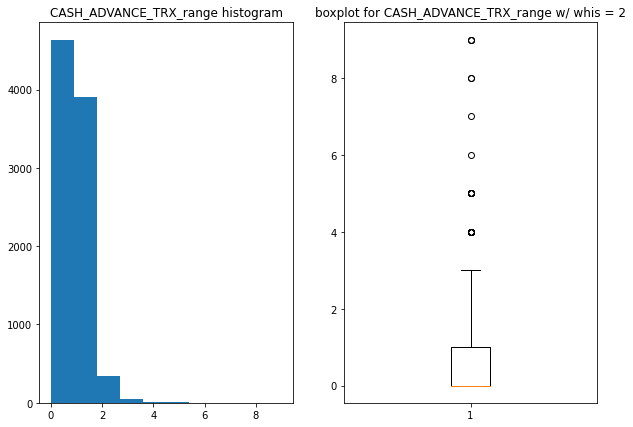

These are graphs for column: PURCHASES_TRX_range


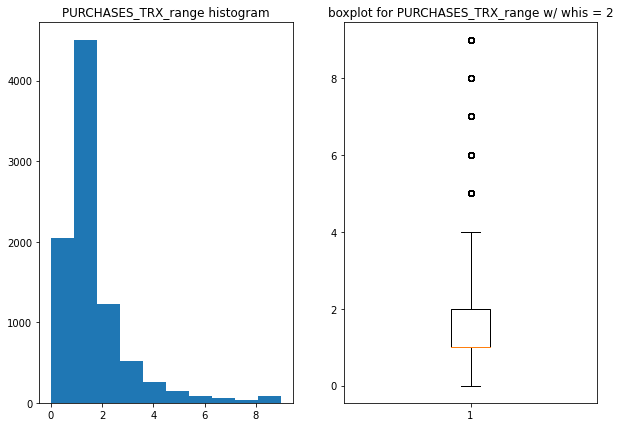

These are graphs for column: PURCHASES_range


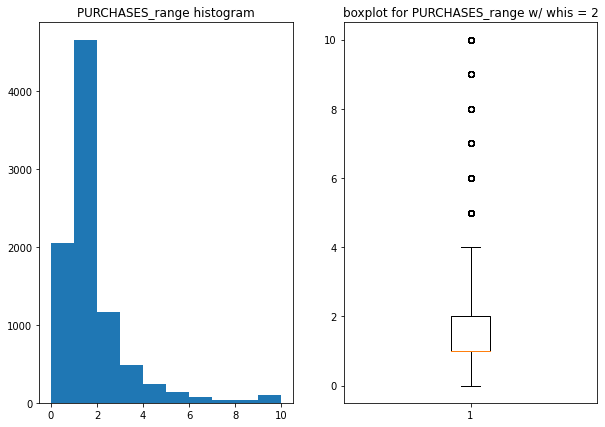

These are graphs for column: ONEOFF_PURCHASES_range


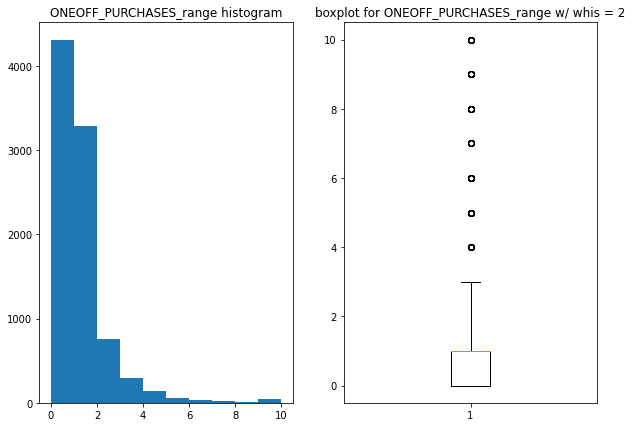

These are graphs for column: CASH_ADVANCE_range


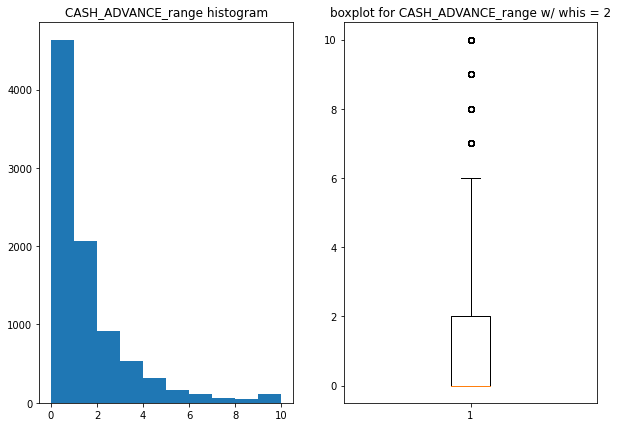

These are graphs for column: PAYMENTS_range


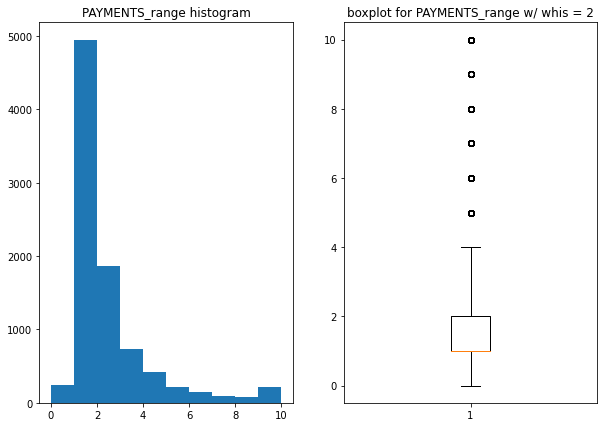

These are graphs for column: MINIMUM_PAYMENTS_range


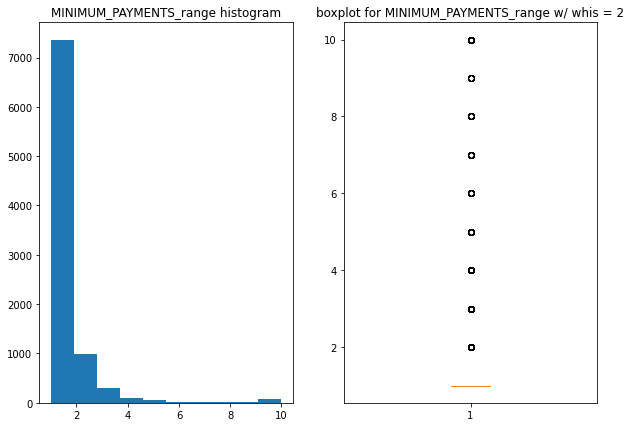

These are graphs for column: BALANCE_range


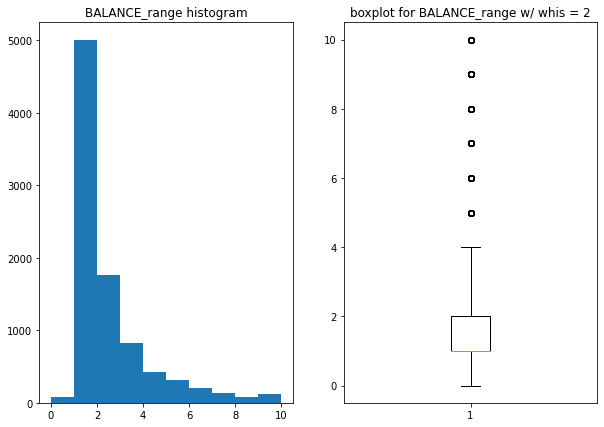

These are graphs for column: INSTALLMENTS_PURCHASES_range


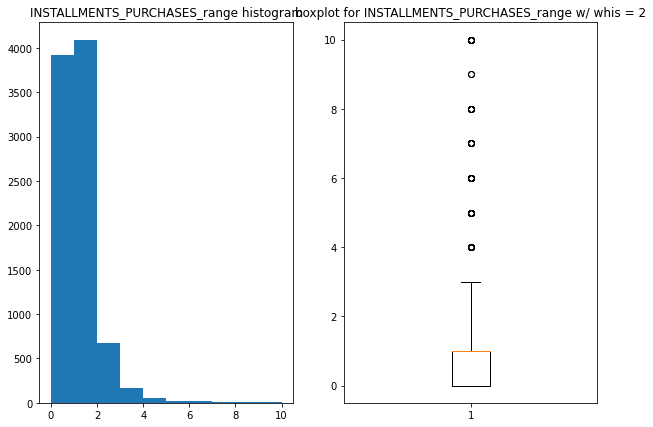

These are graphs for column: CREDIT_LIMIT_range


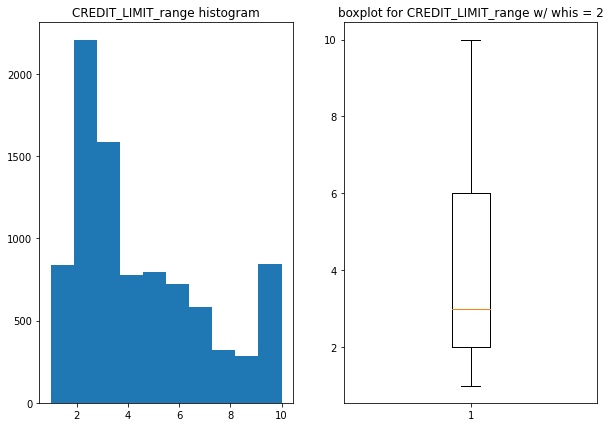

These are graphs for column: BALANCE_FREQUENCY_range


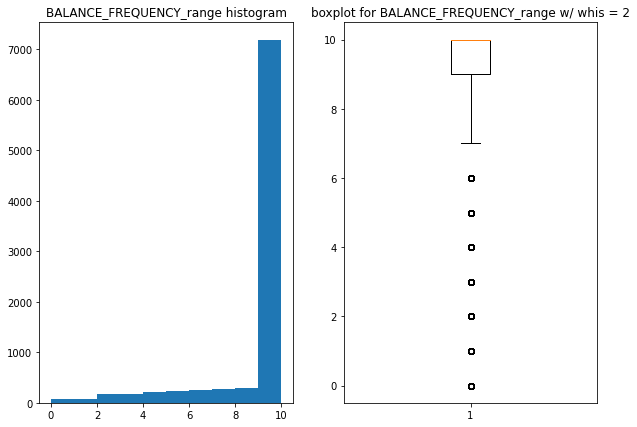

These are graphs for column: PURCHASES_FREQUENCY_range


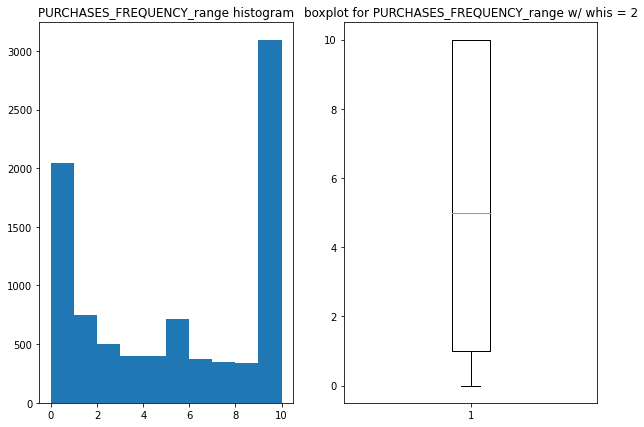

These are graphs for column: ONEOFF_PURCHASES_FREQUENCY_range


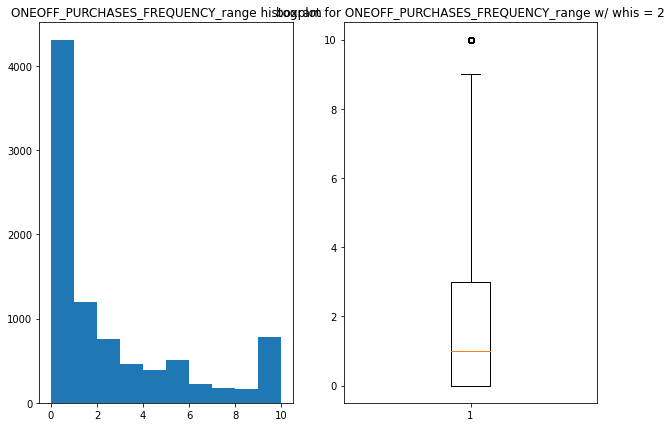

These are graphs for column: PURCHASES_INSTALLMENTS_FREQUENCY_range


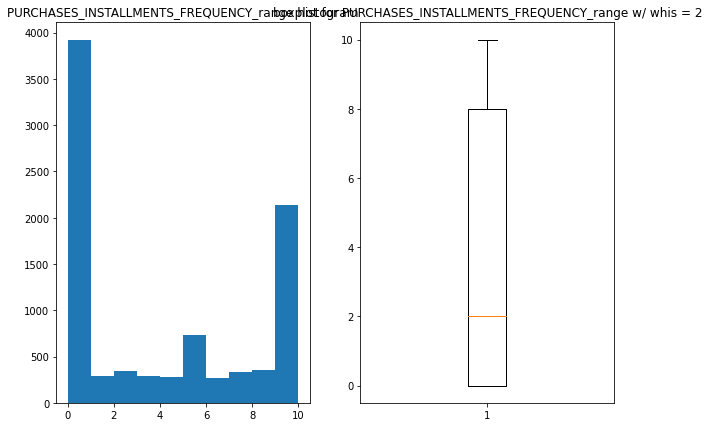

These are graphs for column: CASH_ADVANCE_FREQUENCY_range


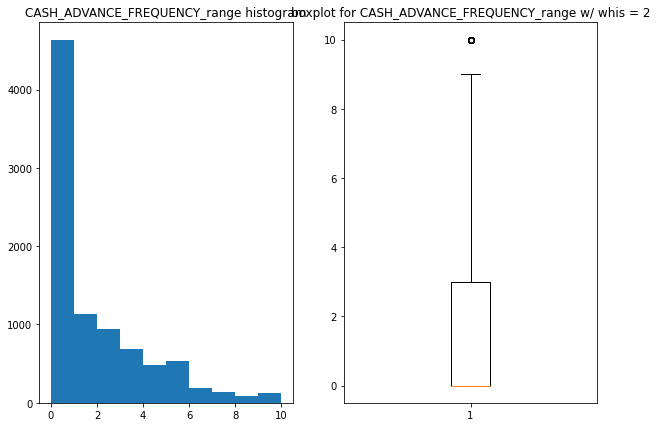

These are graphs for column: PRC_FULL_PAYMENT_range


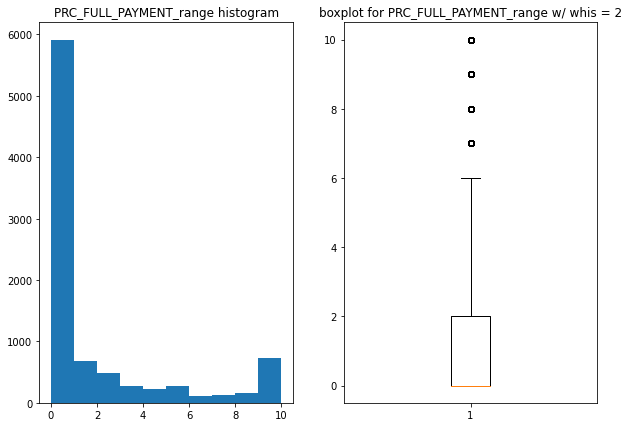

These are graphs for column: TENURE


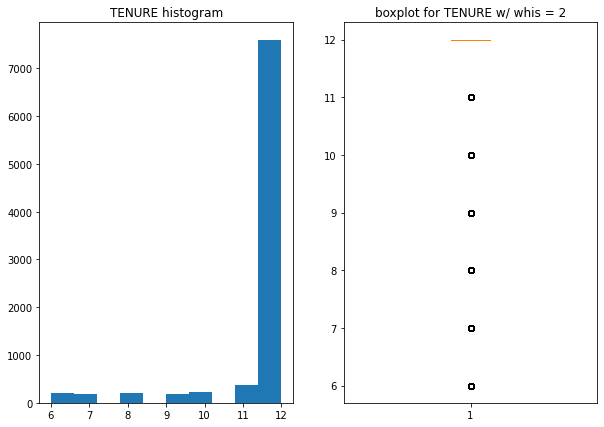

In [0]:
i = 1
y = list(credit_df2.columns)
for column_name in y:
    print("These are graphs for column: {}".format(column_name))
    plt.figure(figsize = (10,7))
    plt.subplot(1,2,i)
    plt.hist(credit_df2[column_name])
    plt.title('{} histogram'.format(column_name))
    i += 1
    plt.subplot(1,2,i)
    plt.boxplot(credit_df2[column_name],whis = 2)
    plt.title('boxplot for {} w/ whis = 2'.format(column_name))
    i = 1 
    plt.tight_layout
    plt.show()

Looks like there are still outliers, but the data is more manageable when it is scaled from 1 to 10

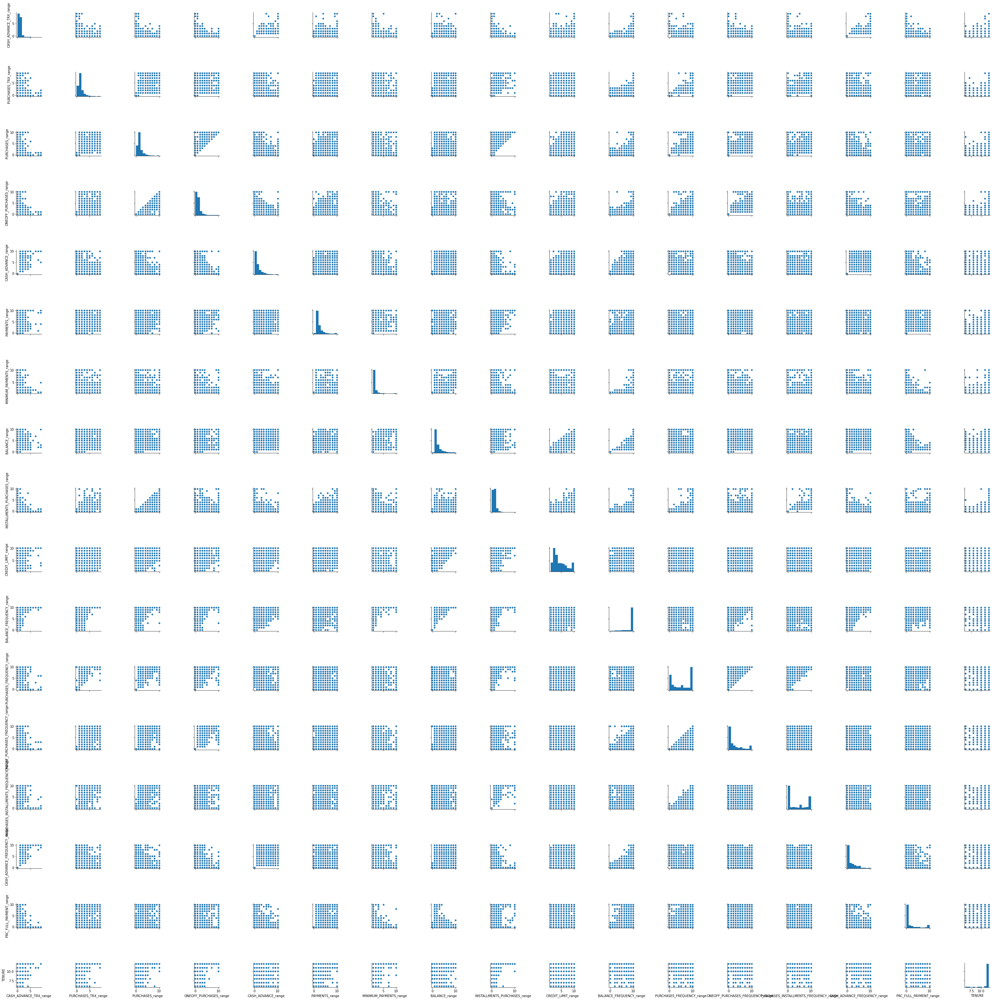

In [0]:
sns.pairplot(credit_df2)

There are a few graphs that look correlated, both positively and negatively. Let us make a correlation matrix to see.

Text(0.5, 1.0, 'correlation matrix ')

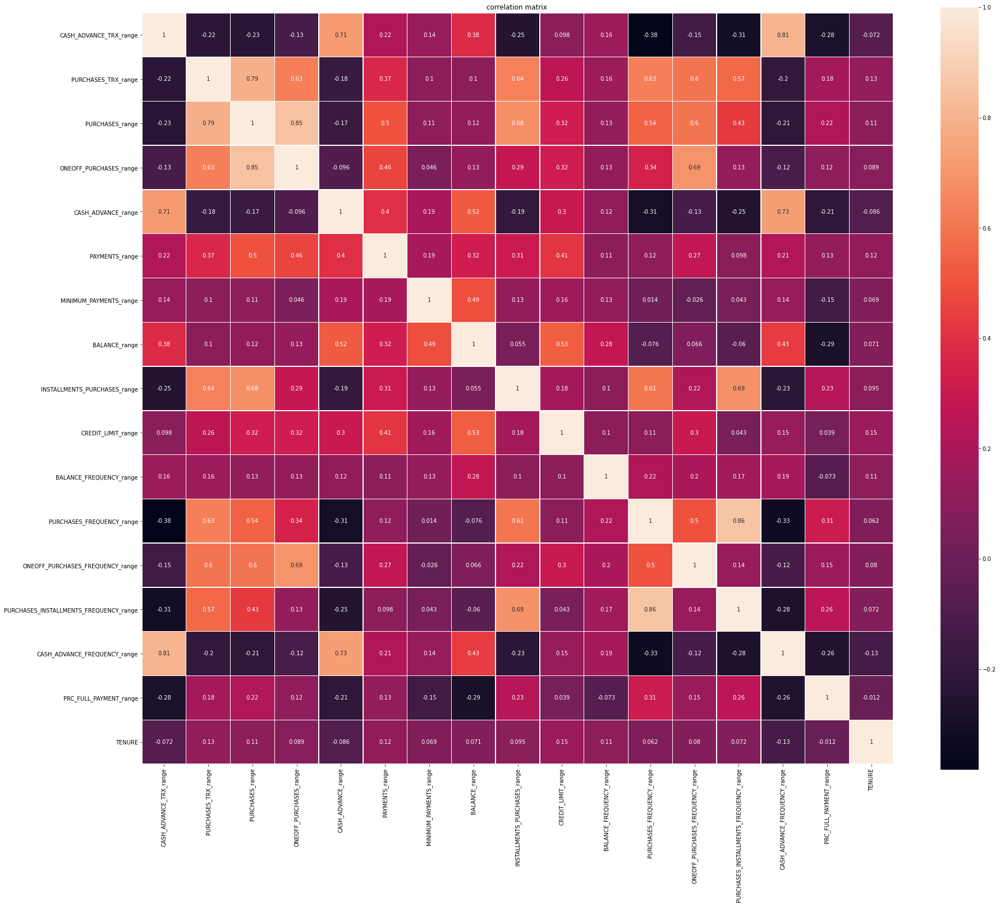

In [0]:
plt.figure(figsize = (30,25))
corrmat = credit_df2.corr()
# draw the heatmap using seaborn.
sns.heatmap(corrmat, square=True, annot=True, linewidths=.5)
plt.title("correlation matrix ")

Again it seems like there is alot of correlations between all features, with tenure being the least correlated to everything. Tenure also had majority the same data, so it does not seem like it would be useful

# Start doing Dimensionality Analysis

In [0]:
credit_df3 = credit_df2.copy()
X1 = credit_df3
#y1 = credit_df2['Class']
# Standarizing the features
scaler = StandardScaler()
X_std = scaler.fit_transform(X1)

# PCA DIMENSIONALITY REDUCTION ANALYSIS

In [0]:
pca_results = PCA(n_components=2).fit_transform(X_std)


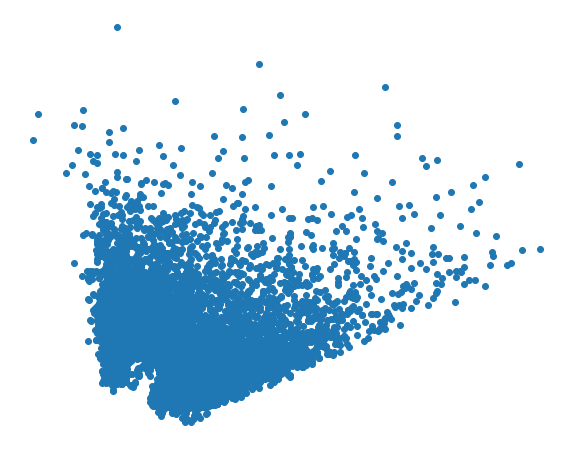

In [0]:
plt.figure(figsize=(10,8))
plt.scatter(pca_results[:, 0], pca_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [0]:
print('\n sillouette score:')
labels = KMeans(n_clusters=2, random_state=1000).fit_predict(pca_results)
print(silhouette_score(pca_results, labels))


 sillouette score:
0.4045345172130723


No obvious groups can be seen, however the sillouette score of 0.4 suggests that the grouping is there.

Now run this dataset with multiple clusters and see which creates the best sillouette score

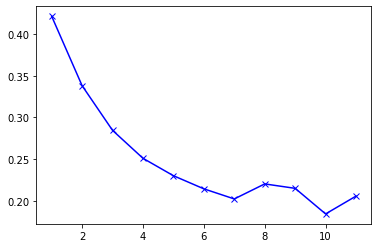

In [0]:
n = 2
scores = []
for i in range(1,12):
  pca_results = PCA(n_components=n).fit_transform(X_std)
  n += 1
  labels = KMeans(n_clusters=5, random_state=1000).fit_predict(pca_results)
  score = silhouette_score(pca_results, labels)
  scores.append(score)
plt.plot(range(1,12),scores, 'bx-')

The best cluster density occurs at n=2 components. However since the goal is trying to cluster more than 2 groups, this would not work well.

## UMAP DIMENSIONALITY REDUCTION

In [0]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=2,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 30.52046847343445 seconds


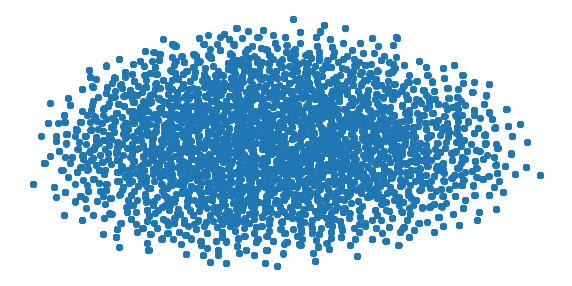

In [0]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [0]:
print('\n sillouette score:')
labels = KMeans(n_clusters=5, random_state=1000).fit_predict(umap_results)
print(silhouette_score(umap_results, labels))


 sillouette score:
0.325064


No obvious groups can be seen, however the sillouette score of 0.32 suggests that the grouping is there.

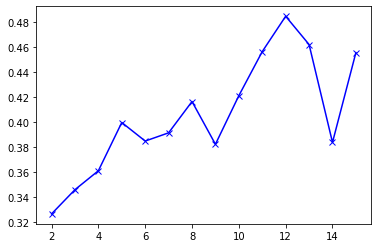

In [0]:
n = 2
scores = []
for i in range(1,15):
  umap_results = umap.UMAP(n_neighbors=n,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)
  n += 1
  labels = KMeans(n_clusters=5, random_state=1000).fit_predict(umap_results)
  score = silhouette_score(umap_results, labels)
  scores.append(score)
plt.plot(range(2,16),scores, 'bx-')

Looks like umap scores the best, and peaks at a neighbor amount of 8-10. 

## T-SNE DIMENSIONALITY REDUCTION

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.059s...
[t-SNE] Computed neighbors for 8950 samples in 2.079s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.639954
[t-SNE] KL divergence after 300 iterations: 2.419030
t-SNE done! Time elapsed: 34.68455171585083 seconds


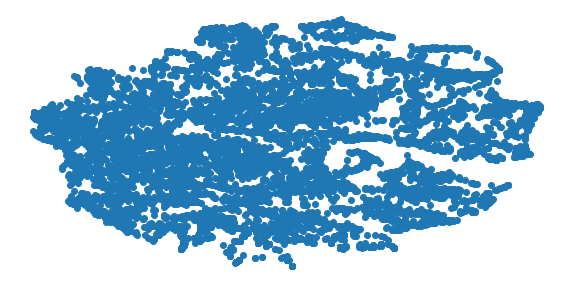

In [0]:

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_std)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))
plt.figure(figsize=(10,5))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [0]:
print('\n sillouette score:')
labels = KMeans(n_clusters=3, random_state=1000).fit_predict(tsne_results)
print(silhouette_score(tsne_results, labels))


 sillouette score:
0.37734237


No obvious groups can be seen, however the sillouette score of 0.38 suggests that the grouping is there.

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.056s...
[t-SNE] Computed neighbors for 8950 samples in 1.875s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.414635
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514

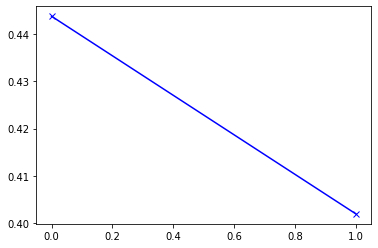

In [0]:
n = 2
scores = []
for i in range(1,3):
  tsne = TSNE(n_components=n, verbose=1, perplexity=30, n_iter=250)
  tsne_results = tsne.fit_transform(X_std)
  n += 1
  labels = KMeans(n_clusters=5, random_state=1000).fit_predict(tsne_results)
  score = silhouette_score(tsne_results, labels)
  scores.append(score)
plt.plot(scores, 'bx-')

Cannot go above 3 for n_components, because TSNE function doesnt allow it. 

UMAP seems to work the best for this dataset. n_components of 8 seem to work well in clustering the data. Create UMAP results below for further analysis of data if needed. However it is understood that dimensional reduction to roughly 8 clusters seems to work.

In [0]:
umap_results = umap.UMAP(n_neighbors=8,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)
tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=250)
tsne_results = tsne.fit_transform(X_std)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.054s...
[t-SNE] Computed neighbors for 8950 samples in 1.914s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.593262
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514

## Now conduct clustering techniques on data to model and find groups 

GAUSIAN CLUSTERING

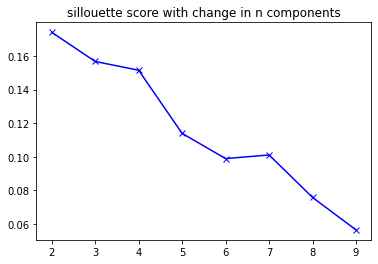

In [0]:
sillhouette = []
for n in range(2,10):
  gmm_cluster = GaussianMixture(n_components=n, random_state=123)

  # Fit model
  clusters = gmm_cluster.fit_predict(X_std)
  sillhouette.append(metrics.silhouette_score(X_std, clusters, metric='euclidean'))

plt.plot(range(2,10),sillhouette, 'bx-')
plt.title('sillouette score with change in n components')
plt.show()

Seems like the ability to accurately cluster datapoints decreases as the amount of clusters increases. This modeling technique will likely not be used

KMEANS CLUSTERING

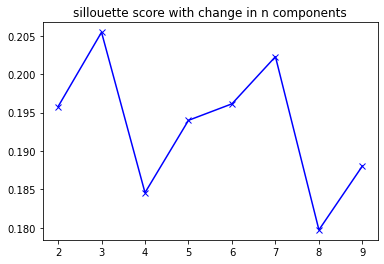

In [0]:
sillhouette = []

for n in range(2,10):
  # Defining the k-means
  kmeans_cluster = KMeans(n_clusters=n, random_state=123)
  kmeans_cluster.fit(X_std)
  # Fit model
  clusters = kmeans_cluster.predict(X_std)
  sillhouette.append(metrics.silhouette_score(X_std,clusters, metric='euclidean'))

plt.plot(range(2,10),sillhouette, 'bx-')
plt.title('sillouette score with change in n components')
plt.show()

Looks like KMEANS provides its best clustering at n = 7. 7 Clusters seems to have sillouette score of 0.2.

Create KMEANS model for the data to be used for future analysis. Also create new column with the KMEANS labels

In [0]:
  kmeans_cluster = KMeans(n_clusters=7, random_state=1000)
  kmeans_cluster.fit(X_std)

  credit_df3['kmeans_labels'] = kmeans_cluster.labels_
  print(credit_df3.kmeans_labels.unique())
  

[0 5 2 6 1 3 4]


DBSCAN APPROACH

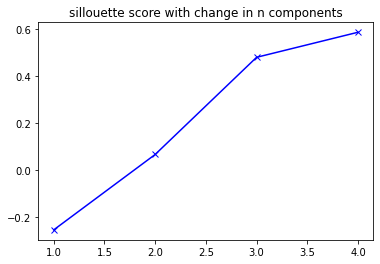

In [0]:
sillhouette = []
for n in range(1,5):
  # Defining the DBSCAN
  dbscan_cluster = DBSCAN(eps=n, min_samples=5)

  # Fit model
  clusters = dbscan_cluster.fit_predict(X_std)
  sillhouette.append(metrics.silhouette_score(X_std,clusters, metric='euclidean'))
plt.plot(range(1,5),sillhouette, 'bx-')
plt.title('sillouette score with change in n components')
plt.show()

This provides a good sillouette score of 0.6 , which shows that the data has a strong density at each cluster. This model seems to work the best out of the others in terms of cluster density. Create a Column in the dataframe with the labels in order to examine the data closer. Seems like a eps value of 2 creates a total of 3 clusters. This will be chosen as 3- 6 create only 2 clusters.

In [0]:
  dbscan_cluster = DBSCAN(eps=2, min_samples=5)

  # Fit model
  dbscan_cluster.fit_predict(X_std)
  credit_df3['dbscan_labels'] = dbscan_cluster.labels_
  print(credit_df3.dbscan_labels.unique())

[ 0 -1  1  2]


HIERARCHAL CLUSTERING

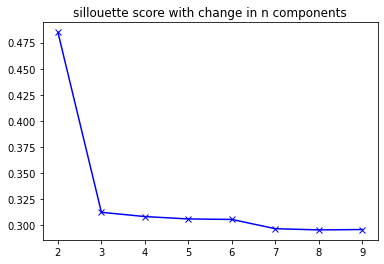

In [0]:
sillhouette = []
for n in range(2,10):
  # Defining the k-means
  # Defining the agglomerative clustering
  agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='euclidean',
                                      n_clusters=n)
  # Fit model
  clusters = agg_cluster.fit_predict(X_std)
  sillhouette.append(metrics.silhouette_score(X_std,clusters, metric='euclidean'))

plt.plot(range(2,10),sillhouette, 'bx-')
plt.title('sillouette score with change in n components')
plt.show()

Looks like heirarchal clustering takes a step down in cluster density at n_components = 2, then it stays even at a score of 0.3, this could be a good clustering technique to use. Seems like clusters of 6 to 8 can be used. Since we saw KMeans was roughly 7 clusters, we can use that


In [0]:
agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='euclidean',
                                      n_clusters=7)
# Fit model
agg_cluster.fit_predict(X_std)
credit_df3['agg_clust_labels'] = agg_cluster.labels_

### Now that we have the labels in the dataframe it is time to analyze the data for each cluster, and see if we can make a connection

In [0]:
print(credit_df3.agg_clust_labels.unique())
print(credit_df3.dbscan_labels.unique())
print(credit_df3.kmeans_labels.unique())
columns = list(credit_df3.columns)
pd.options.display.max_columns = None


[2 3 0 4 1 5 6]
[ 0 -1  1  2]
[0 5 2 6 1 3 4]


print histogram of columns for each cluster to compare differences

## DBSCAN DESCRIPTIONS

In [0]:
  l = 1
  for i in range(-1,2):
    new = credit_df3.dbscan_labels == i
    
    df = credit_df3[new]
    print('description of cluster {}'.format(l))
    print(tabulate(df.describe(),headers= df.columns))
    print('\n\n')
    l += 1

description of cluster 1
         CASH_ADVANCE_TRX_range    PURCHASES_TRX_range    PURCHASES_range    ONEOFF_PURCHASES_range    CASH_ADVANCE_range    PAYMENTS_range    MINIMUM_PAYMENTS_range    BALANCE_range    INSTALLMENTS_PURCHASES_range    CREDIT_LIMIT_range    BALANCE_FREQUENCY_range    PURCHASES_FREQUENCY_range    ONEOFF_PURCHASES_FREQUENCY_range    PURCHASES_INSTALLMENTS_FREQUENCY_range    CASH_ADVANCE_FREQUENCY_range    PRC_FULL_PAYMENT_range     TENURE    kmeans_labels    dbscan_labels    agg_clust_labels
-----  ------------------------  ---------------------  -----------------  ------------------------  --------------------  ----------------  ------------------------  ---------------  ------------------------------  --------------------  -------------------------  ---------------------------  ----------------------------------  ----------------------------------------  ------------------------------  ------------------------  ---------  ---------------  ---------------  ------

K means seems to work better than DBSCAN. Notice that some groups only have 5 or 180 datapoints grouped in the cluster, meaning the dataset is not doing a great job of seperating points. The goal of this model is to create a more generalized grouping system, and this doesnt seem to meet that.

## AgglomerativeClustering descriptions

In [0]:
  l = 1
  for i in range(0,7):
    new = credit_df3.agg_clust_labels == i
    
    df = credit_df3[new]
    print('description of cluster {}'.format(l))
    print(tabulate(df.describe(),headers= df.columns))
    print('\n\n')
    l += 1

description of cluster 1
         CASH_ADVANCE_TRX_range    PURCHASES_TRX_range    PURCHASES_range    ONEOFF_PURCHASES_range    CASH_ADVANCE_range    PAYMENTS_range    MINIMUM_PAYMENTS_range    BALANCE_range    INSTALLMENTS_PURCHASES_range    CREDIT_LIMIT_range    BALANCE_FREQUENCY_range    PURCHASES_FREQUENCY_range    ONEOFF_PURCHASES_FREQUENCY_range    PURCHASES_INSTALLMENTS_FREQUENCY_range    CASH_ADVANCE_FREQUENCY_range    PRC_FULL_PAYMENT_range      TENURE    kmeans_labels    dbscan_labels    agg_clust_labels
-----  ------------------------  ---------------------  -----------------  ------------------------  --------------------  ----------------  ------------------------  ---------------  ------------------------------  --------------------  -------------------------  ---------------------------  ----------------------------------  ----------------------------------------  ------------------------------  ------------------------  ----------  ---------------  ---------------  ----

Again KMEANs seems to do a better job at clustering more general groups. So KMEANS will be the model of choice. 

## K MEANS HISTOGRAMS and DESCRIPTIONS

histogram of columns

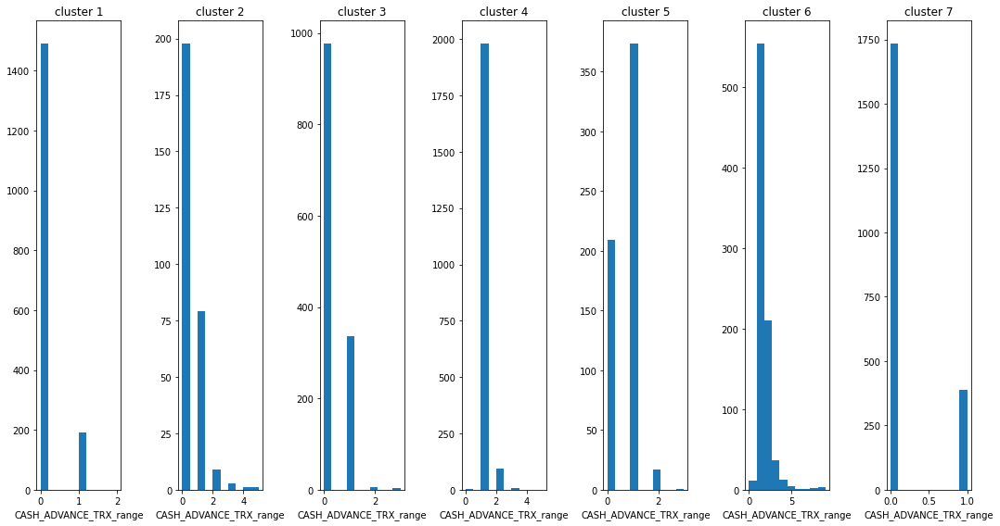

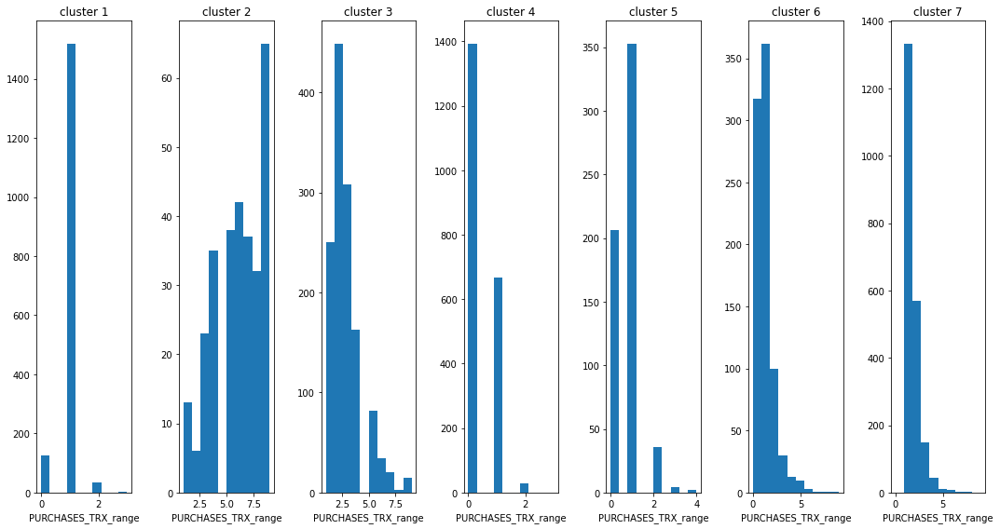

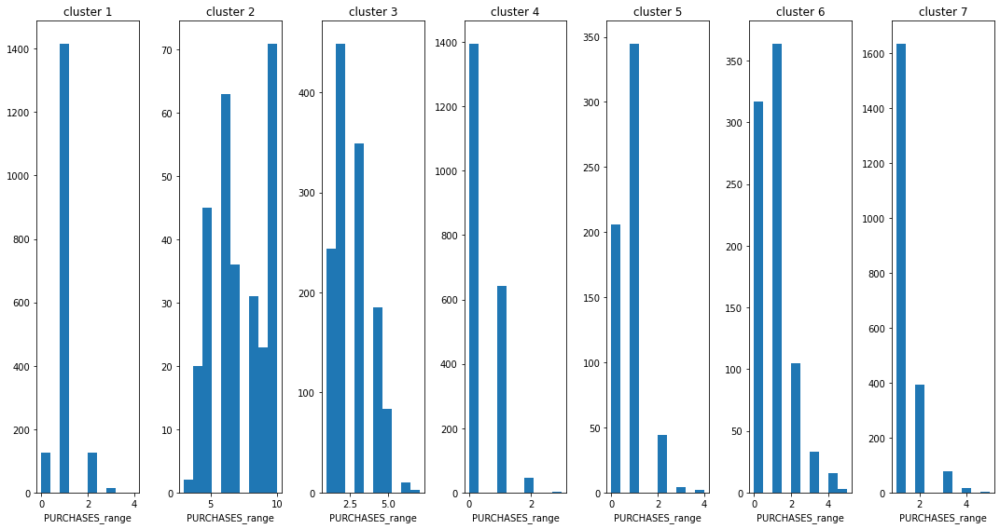

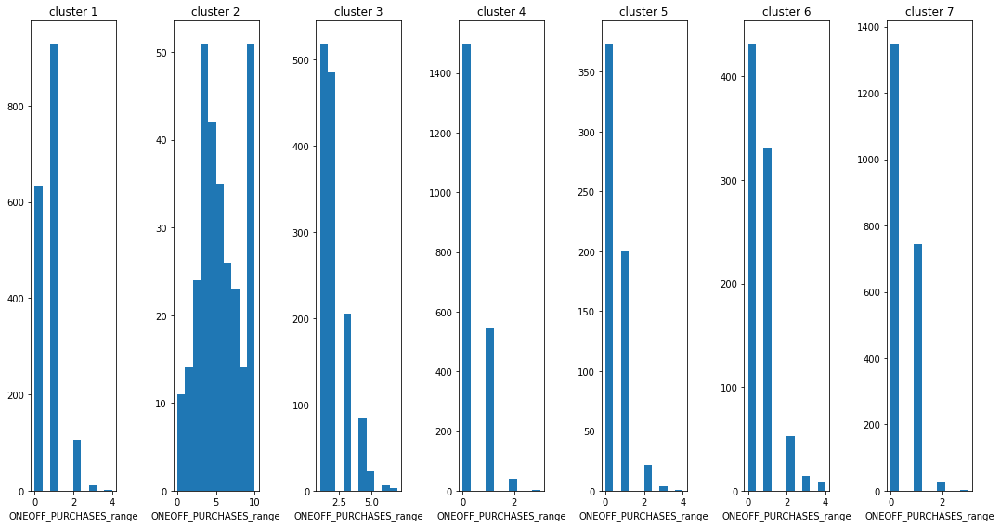

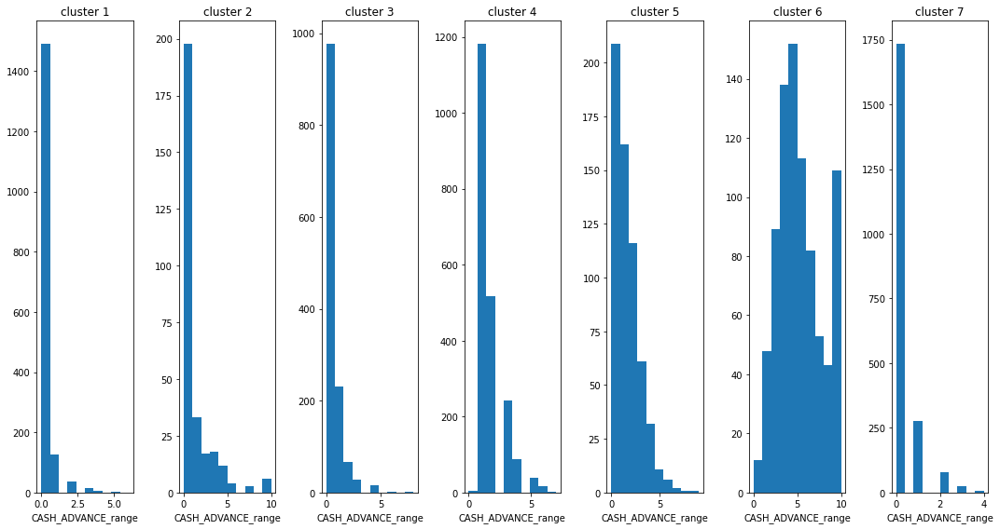

...

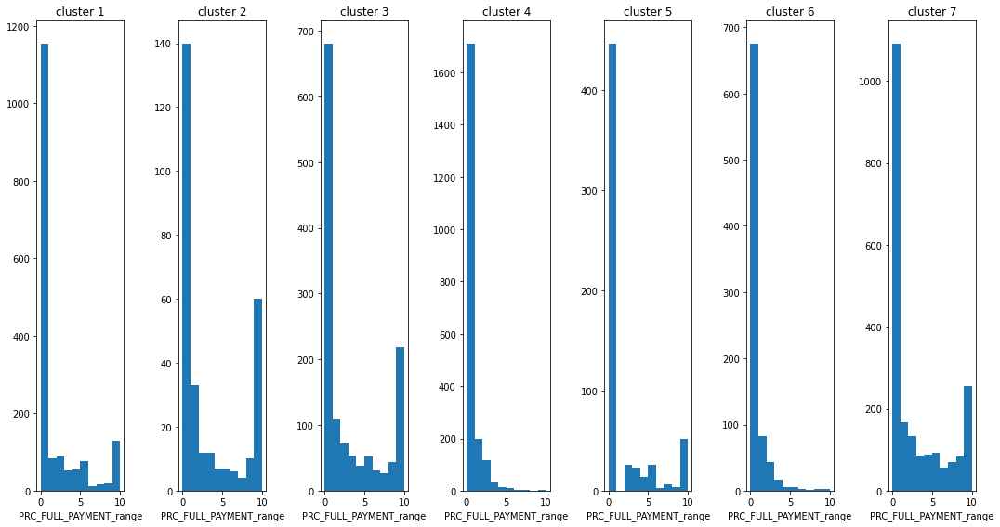

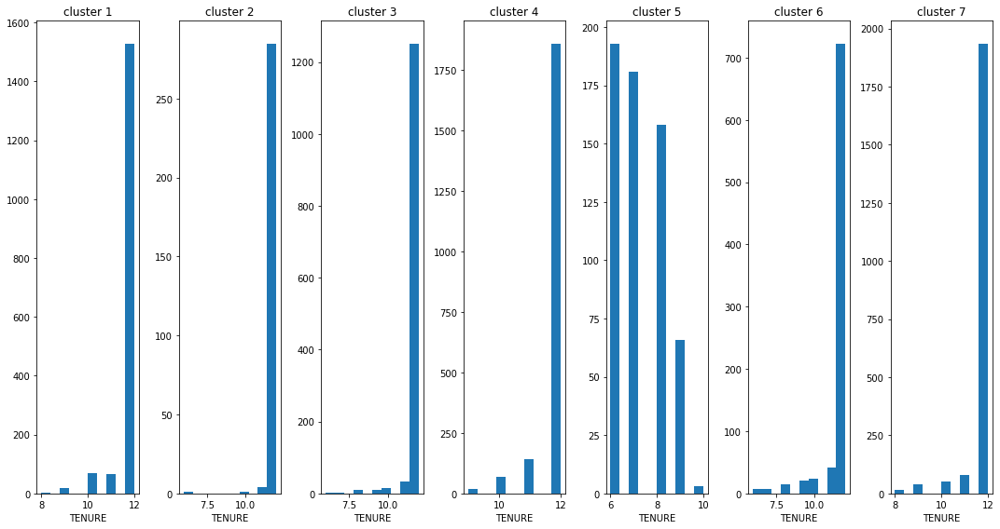

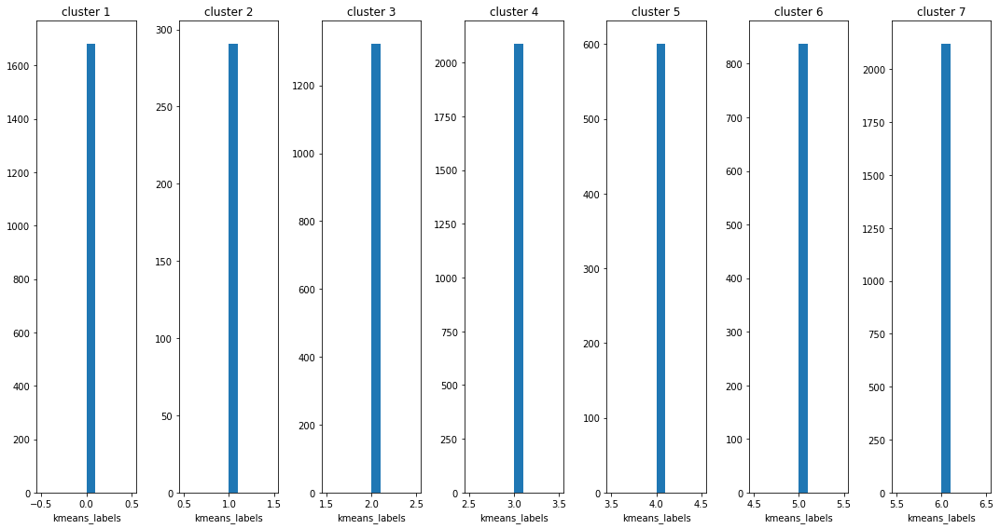

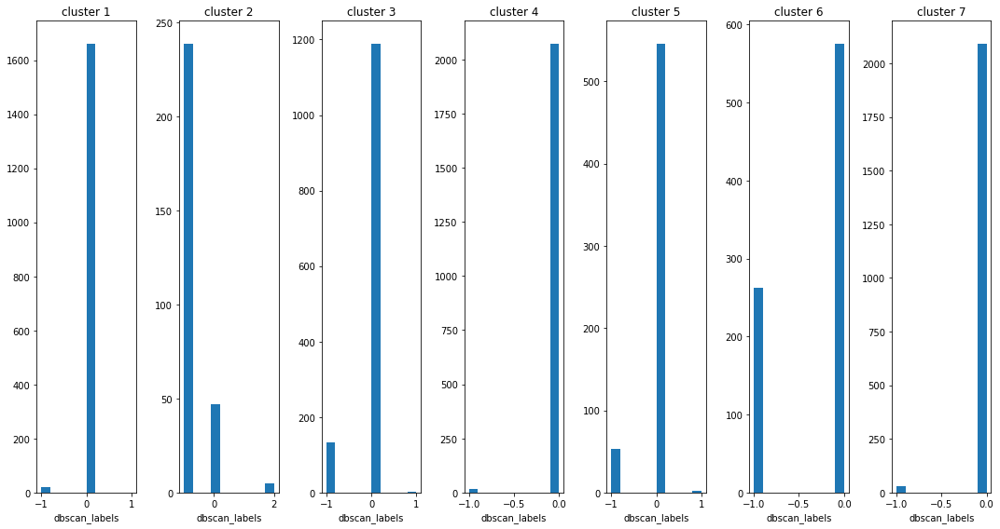

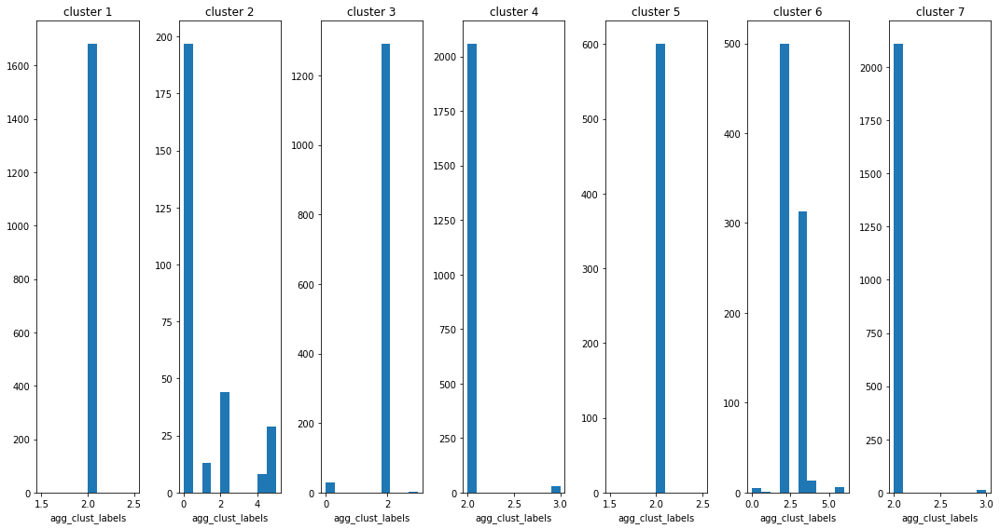

In [0]:
for col in columns:
  l = 1
  plt.figure(figsize= (15,8))
  for i in range(0,7):
    new = credit_df3.kmeans_labels == i
    plt.subplot(1,7,l)
    df = credit_df3[new]
    plt.hist(df[col])
    plt.title('cluster {}'.format(l))
    plt.xlabel('{}'.format(col))
    l += 1
  plt.tight_layout()
  plt.show()

Description of columns

In [0]:
  l = 1
  for i in range(0,7):
    new = credit_df3.kmeans_labels == i
    
    df = credit_df3[new]
    print('description of cluster {}'.format(l))
    print(tabulate(df.describe(),headers= df.columns))
    print('\n\n')
    l += 1

description of cluster 1
         CASH_ADVANCE_TRX_range    PURCHASES_TRX_range    PURCHASES_range    ONEOFF_PURCHASES_range    CASH_ADVANCE_range    PAYMENTS_range    MINIMUM_PAYMENTS_range    BALANCE_range    INSTALLMENTS_PURCHASES_range    CREDIT_LIMIT_range    BALANCE_FREQUENCY_range    PURCHASES_FREQUENCY_range    ONEOFF_PURCHASES_FREQUENCY_range    PURCHASES_INSTALLMENTS_FREQUENCY_range    CASH_ADVANCE_FREQUENCY_range    PRC_FULL_PAYMENT_range       TENURE    kmeans_labels    dbscan_labels    agg_clust_labels
-----  ------------------------  ---------------------  -----------------  ------------------------  --------------------  ----------------  ------------------------  ---------------  ------------------------------  --------------------  -------------------------  ---------------------------  ----------------------------------  ----------------------------------------  ------------------------------  ------------------------  -----------  ---------------  ---------------  --

K means seems to seperate the data into pretty large chunks. It also has a silhouette score of 0.2, which isnt the best but the fact that its groups have more then 500 datapoints in them  may be worth keeping. The goal is to have more of a generalized set of groups, which this acheives. Now review the groups and describe what each group consists of.

## It is clear that KMEANS is the best clustering model to use for this dataset. Now also create descriptions for the clusters in the feature engineering data set



### CLUSTER 1



1.   Has 1600 datapoints in the cluster. 
2.   Everything has a mean of roughly 1 except
3.   CASH ADVANCE of roughly 0
4.   CREDIT LIMIT of roughly 3.8
5.   BALANCE FREQUENCY of roughly 6
6.   TENURE of 12

To summarize: These are clients who do not take out cash advances. They have an average credit limits and dont make very many large purchases. They do make smaller purchases. If a marketing strategy is chosen it should stay clear of large purchases.



### CLUSTER 2



1.   Has 291 datapoints in the cluster. 
2.   BALANCE_FREQUENCY,PURCHASES_FREQUENCY, ONEOFF_PURCHASES_FREQUENCY    PURCHASES_INSTALLMENTS_FREQUENCY are all above 7 (relatively high)
3.   CASH ADVANCE of roughly 0.3
4.   PURCHASES_TRX,PURCHASES, ONEOFF_PURCHASES are around 5-7
5.   CREDIT LIMIT average of 8
6.   TENURE of 12
7.   PAYMENTS of 6

To summarize: These are clients who use their cards alot. They have an above average credit limits and make alot of purchases. They do make smaller purchases, and have a higher than normal amount of large purchases too. This group could be targeted for both large and small purchases, and may respond well to percent reward plans. It seems that they tend to use their cards for most purchases so household items , groceries, and shopping are all options.

### CLUSTER 3



1.   Has 1324 datapoints in the cluster. 
2.   Everything is low except:
3.    BALANCE_FREQUENCY, PURCHASES_FREQUENCY, ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY are above 7
4.   CREDIT LIMIT of roughly 5
5.   TENURE of 12

To summarize: These are clients who use their cards alot. They have an average credit limit and make alot of large purchases. They do make smaller purchases, but have a higher than normal "large", "installment" or "bulk" purchase rate. This group could be targeted for both large and small purchases, and may respond well to percent reward plans, or discounted phone/car plans

### CLUSTER 4



1.   Has 2090 datapoints in the cluster. 
2.   Everything has a mean of roughly 1 except
3.   CASH ADVANCE relatively high at 1.
4.   CREDIT LIMIT of roughly 3.5
5.   BALANCE FREQUENCY of roughly 9.66
6.   TENURE of 12

To summarize: These are clients who use their cards alot for cash advances. They have below average credit and use their balance to get cash for items they will not be able to pay at a current time. The marketing strategy for this group should include installment payements, lower minimum required payments, no fees on cash advance, etc. This group is definitely riskier and may need to have a strategy of having a lower credit limit.

### CLUSTER 5



1.   Has 601 datapoints in the cluster. 
2.   Everything has a mean of roughly 1 except
3.   CASH ADVANCE of roughly 0
4.   CREDIT LIMIT of roughly 2.6
5.   BALANCE FREQUENCY of roughly 8
6.   TENURE avg of 7 
7.   Purchase frequency of 4

To summarize: These are clients who are new to their cards. Their tenure is below average which is the age of the accounts. These clients do not use their cards for very much besides small purchases, likely students or people who are trying to build their credit. Reward plans for smaller items may be the best strategy for them including gas and groceries.

### CLUSTER 6



1.   Has 800 datapoints in the cluster. 
2.   Everything has a mean of roughly 1 except
3.   CASH ADVANCE of roughly 5 and cash advance TRX of 1.4 (high)
4.   CREDIT LIMIT of roughly 7.8
5.   BALANCE FREQUENCY of roughly 9.76
6.   TENURE of 12
7.   PURCHASES_INSTALLMENTS_FREQUENCY of 2.5  CASH_ADVANCE_FREQUENCY of 5

To summarize: These are clients who use their cards for cash advances. They have old accounts and an above average credit limit. Their cards are used alot for buying items they cant afford at the time. Likely are people living paycheck to paycheck. Marketing strategies should stick to essential household/work items and should recognize this group is riskier.

### CLUSTER 7



1.   Has 2123 datapoints in the cluster. 
2.   Everything has a mean of roughly 1 except
3.   PURCHASES_FREQUENCY,   PURCHASES_INSTALLMENTS_FREQUENCY of 8
4.   CREDIT LIMIT of roughly 3.3


##  Now also create descriptions for the clusters in the original data set for comparison



In [0]:
  scaler = StandardScaler()
  X_std = scaler.fit_transform(credit_df)
  kmeans_cluster = KMeans(n_clusters=7, random_state=1000)
  kmeans_cluster.fit(X_std)
  
  credit_df['kmeans_labels'] = kmeans_cluster.labels_
  print(credit_df3.kmeans_labels.unique())
  
  l = 1
  for i in range(0,7):
    new = credit_df.kmeans_labels == i
    df = credit_df[new]
    #df.values = scaler.inverse_transform(df.values)
    print('description of cluster {}'.format(l))
    print(tabulate(df.describe(),headers= df.columns))
    print('\n\n')
    l += 1

[0 5 2 6 1 3 4]
description of cluster 1
           BALANCE    BALANCE_FREQUENCY    PURCHASES    ONEOFF_PURCHASES    INSTALLMENTS_PURCHASES    CASH_ADVANCE    PURCHASES_FREQUENCY    ONEOFF_PURCHASES_FREQUENCY    PURCHASES_INSTALLMENTS_FREQUENCY    CASH_ADVANCE_FREQUENCY    CASH_ADVANCE_TRX    PURCHASES_TRX    CREDIT_LIMIT    PAYMENTS    MINIMUM_PAYMENTS    PRC_FULL_PAYMENT       TENURE    kmeans_labels
-----  -----------  -------------------  -----------  ------------------  ------------------------  --------------  ---------------------  ----------------------------  ----------------------------------  ------------------------  ------------------  ---------------  --------------  ----------  ------------------  ------------------  -----------  ---------------
count   1267               1267              1267               1267                      1267           1267                 1267                          1267                                1267                      1267       

### CLUSTER 1



1.   Has 1267 datapoints in the cluster. 
2.   Low cash advances
3.   Alot of purchases, 30% payback rate of balance, Balance kept relatively low. 
4.   Higher than average credit score


To summarize: These are clients with high credit utilization, put alot of money on cards and have a good rate of paying back credit. This is a good group to try to encourage spending. 



### CLUSTER 2



1.   Has 894 datapoints in the cluster. 
2.   average credit limit
3.   high amount of balance left over
4.   high cash advance limit 


This is a riskier group. Likely to take cash advance with very low "full payments" on balance. This group builds debt and doesnt seem to pay it off fully. Keeping credit limits low while also trying to encourage "day to day " spending may be a solid marketing strategy. Goal is to make interest off low amounts, due to likihood of missing payments/defaults

### CLUSTER 3



1.   Has 86 datapoints in the cluster, likely an outlier group.
2.   High Credit
3.   High spending, especially on one time purchases.
4.   High full balance payments

This is a good group likly with high credit scores. The cards are used for large purchases. 40% of the time they will fully pay back the lent amount. Target audience for larger items, due to lower risk. 

### CLUSTER 4



1.   Has 2046 datapoints in the cluster. 
2.   Relatively low amounts of balances, purchases average around 1000 dollars which is above average 
3.   CASH ADVANCE low
4.   Installment purchases high, with higher payoff rate of balance

This group should be targeted for installment purchases. These credit accounts are used to make purchases on phones, cars, etc..  That should be where the marketing strategy is focused on.

### CLUSTER 5



1.   Has 1187 datapoints in the cluster. 
2.   These accounts have low credit limits
3.   These accounts dont purchase very much, and tend to pay back their accounts 


The investment strategy would be to give rewards on lower priced items. Since this group wont be making large purchases, giving small benefits on smaller items would encourage more spending.


### CLUSTER 6



1.   Has 629 datapoints in the cluster. 
2.   CREDIT LIMIT is low under 3000
3.   relatively low purchases and high cash advance
4.   fully pay back at a rate of 0.2 and have a low credit age 


This group is a little bit risky, they mostly collect cash advances and are likely living paycheck to paycheck. The group has had their credit for shorter then most, and might be growing their score. The marketing strategy with this group would be based around cash advances and lower credit limits. However this group does tend to make payments.

### CLUSTER 7



1.   Has 2841 datapoints in the cluster. 
2.   Cash advance relatively high
3.   CREDIT LIMIT Low and low chances of paying off lones

This is a risky group, they have higher balances on their accounts and lower chances of fully paying off their accounts. They also do cash advances which also makes it likely they are living paycheck to paycheck. This is a risky group. 


##  2D plot with colors to show clusters of dataset

 ### PCA Plot

In [0]:
X1 = credit_df.drop(columns = 'kmeans_labels') 
X2 = credit_df3.drop(columns = 'kmeans_labels') 
#y1 = credit_df2['Class']
# Standarizing the features
scaler = StandardScaler()
X_std1 = scaler.fit_transform(X1)
X_std2 = scaler.fit_transform(X2)
y1 = credit_df.kmeans_labels
y2 = credit_df3.kmeans_labels

In [0]:
# We just want the first two principal components
pca = PCA(n_components=2)

# We get the components by 
# calling fit_transform method with our data
pca_components1 = pca.fit_transform(X_std1)
pca_components2 = pca.fit_transform(X_std2)

#### Plot of original Data

In [0]:

plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca_components1.shape[0]):
    plt.text(pca_components1[i, 0], pca_components1[i, 1], str(y1[i]),
             color=colours[int(y1[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

#### Plot of feature engineered data

In [0]:

plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca_components2.shape[0]):
    plt.text(pca_components2[i, 0], pca_components2[i, 1], str(y2[i]),
             color=colours[int(y2[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

###  UMAP Plot

#### original Dataset umap plot

In [0]:
umap_results1 = umap.UMAP(n_neighbors=8,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std1)
plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results1.shape[0]):
    plt.text(umap_results1[i, 0], umap_results1[i, 1], y1[i],
             color=colours[int(y1[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

#### Feature engineered Dataset umap plot

In [0]:
umap_results2 = umap.UMAP(n_neighbors=8,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std2)
plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results2.shape[0]):
    plt.text(umap_results2[i, 0], umap_results2[i, 1], y2[i],
             color=colours[int(y2[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

###  TSNE Plot

#### original Dataset TSNE plot

In [0]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results1 = tsne.fit_transform(X_std1)
plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(tsne_results1.shape[0]):
    plt.text(tsne_results1[i, 0], tsne_results1[i, 1], str(y1[i]),
             color=colours[int(y1[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.032s...
[t-SNE] Computed neighbors for 8950 samples in 3.130s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.468710
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.664093
[t-SNE] KL divergence after 300 iterations: 2.516429


#### feature engineered Dataset TSNE plot

In [0]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results2 = tsne.fit_transform(X_std2)
plt.figure(figsize=(10,7))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(tsne_results2.shape[0]):
    plt.text(tsne_results2[i, 0], tsne_results2[i, 1], str(y2[i]),
             color=colours[int(y2[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.137s...
[t-SNE] Computed neighbors for 8950 samples in 3.500s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.355896
[t-SNE] KL divergence after 300 iterations: 2.338465


# Conclusion 

#### Umap/PCA/TSNE color 2d plot with labels

TSNE PLOTS

The original data provides better and more isolated groups, while the featured set seems to blur the groups together more. The original data seems to be the better of the two data sets with TSNE dimensionality reduction.

PCA PLOTS

The clusters in the original dataset are alot more spread apart. When feature engineering is conducted to change the datapoints into range values, the clusters are more densely grouped together. The original dataset works better for PCA dimensionality reduction.

UMAP PLOTS

These plots do not do that great of a job making good 2D visuals. The data from the original data looks to be grouped together, while the feature set seems to have alot more mixture between the clusters. The original data seems to be the better of the two data sets for UMAP dimensionality reduction.

#### Differences between original dataset and ranged dataset

In conclusion the original dataset without feature engineering done was the model that worked the best with dimensional reduction. This was shown in the collored plots above. 

The clusters that were made from the featured and original datasets were similar as shown in the descriptions above. The clusters were seperated the same way:

1.   High/Low Credit Limits
2.   High/Low rates of paying back balances
3.   Rates of Cash Advances/ Purchases
4.   Both seem to have seperated high and low risk groups. 



The original dataset below is the what is chosen for the final model. This is the dataset without the ranges that were created.

In the future:

1. Analysis on each group can be done to clean up the clusters. This can look at individual clusters and see if merging two clusters would be ideal. This will utilize the descriptions/dimensional reduction.

2. This data essentially created groups of credit accounts that require different marketing strategies for credit companies. Further analysis of the seperated groups can be done to create more in depth strategies for each cluster. 

3. This model can increase the cluster amounts to have more groups. This will create alot more unique groups. This will help increase information for marketing strategies. The reason this was not done originally is because of the goal to create a more general understanding of the data. 

